In [1]:
from pyCific.Tools import H5Utils
import os
import importlib
import pandas
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt
from pyCific.SpotFinding import spotFinder
from pyCific.Segmentation import plateSegmentation
from pyCific.Tools import miscUtils
from pyCific.Tools import plotUtils
%config IPCompleter.use_jedi = False
import tifffile

In [2]:
import logging
logger = logging.getLogger()
logger.setLevel(logging.DEBUG)
logger.addHandler(logging.StreamHandler())

In [3]:
os.chdir('M:/AST-ID-QC/2018/IntensityStudy/Analyte_Response/Lab_Analyte/H2S/')

In [4]:
os.listdir()

['region2_QC_H2S_trial3',
 'region1_QC_H2S_trial3',
 'region1_QC_H2S_trial5',
 'region2_QC_H2S_trial5',
 'region1_QC_H2S_trial1',
 'region1_QC_H2S_trial2',
 'region2_QC_H2S_trial4',
 'region2_QC_H2S_trial2',
 'region2_QC_H2S_trial1',
 'region1_QC_H2S_trial4']

In [5]:
cd ./region1_QC_H2S_trial1/

M:\AST-ID-QC\2018\IntensityStudy\Analyte_Response\Lab_Analyte\H2S\region1_QC_H2S_trial1


In [246]:
imageList = sorted(miscUtils.getFileList('*.tiff'))

In [247]:
imageList

['.\\region1_QC_SO2_trial1\\Images\\2018-04-10_14-05-49_incubation.tiff',
 '.\\region1_QC_SO2_trial1\\Images\\2018-04-10_14-06-21_incubation.tiff',
 '.\\region1_QC_SO2_trial1\\Images\\2018-04-10_14-06-51_incubation.tiff',
 '.\\region1_QC_SO2_trial1\\Images\\2018-04-10_14-07-22_incubation.tiff',
 '.\\region1_QC_SO2_trial1\\Images\\2018-04-10_14-07-52_incubation.tiff',
 '.\\region1_QC_SO2_trial1\\Images\\2018-04-10_14-08-23_incubation.tiff',
 '.\\region1_QC_SO2_trial1\\Images\\2018-04-10_14-08-53_incubation.tiff',
 '.\\region1_QC_SO2_trial1\\Images\\2018-04-10_14-09-24_incubation.tiff',
 '.\\region1_QC_SO2_trial1\\Images\\2018-04-10_14-09-54_incubation.tiff',
 '.\\region1_QC_SO2_trial1\\Images\\2018-04-10_14-10-25_incubation.tiff',
 '.\\region1_QC_SO2_trial1\\Images\\2018-04-10_14-11-41.tiff',
 '.\\region1_QC_SO2_trial1\\Images\\2018-04-10_14-12-11.tiff',
 '.\\region1_QC_SO2_trial1\\Images\\2018-04-10_14-12-42.tiff',
 '.\\region1_QC_SO2_trial1\\Images\\2018-04-10_14-13-12.tiff',
 '.\\reg

In [8]:
image = tifffile.imread(imagelist[0])

### Note that I have rotated the images using  'mogrify -rotate "180" *.tiff' 

(<matplotlib.figure.Figure at 0x16a997a9780>,
 <matplotlib.image.AxesImage at 0x16a9e1eff98>)

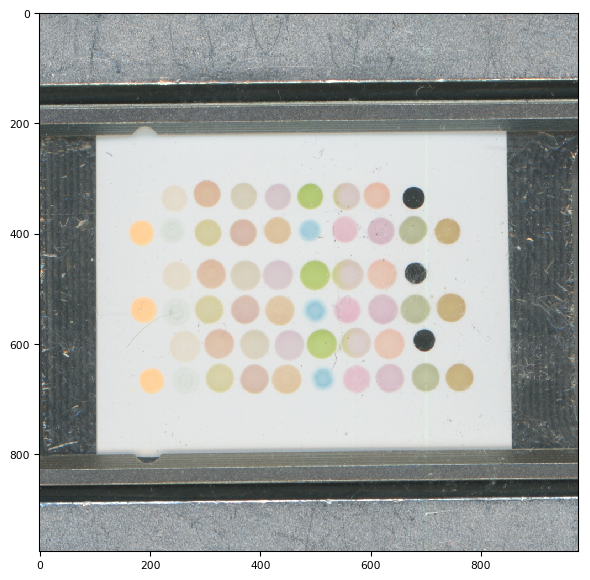

In [9]:
tifffile.imshow(image)

In [253]:
importlib.reload(H5Utils)

<module 'pyCific.Tools.H5Utils' from 'C:\\PYTHON\\pyCific\\Tools\\H5Utils.py'>

# Step one: Create H5 File

In [137]:
filebase = os.path.basename(os.getcwd())
h5filename = filebase + '.h5'
sensor = 'QC-Rev11-Q1-60'
sensorDict = {}
sensorDict['A1'] = sensor
h = H5Utils.h5Parser(h5filename, sensorConfigDictString=str(sensorDict), forceNewFile=True)

Opening file H2S.h5 in w mode
H5File opened in w mode
astConfigDict not found in attr.keys() = KeysView(<Attributes of HDF5 object at 1558191805984>)
 writeSensorConfig Dict:: {'A1': 'QC-Rev11-Q1-60'}
Writing astConfigDict as attribute
key: astConfigDict, value: {"A1": {"config": "QC-REV11-Q1-60", "segmentation": {"minBoundingRectAreaFraction": 0.2, "maxBoundingRectAreaFraction": 0.8, "maxBoundingRectAspectRaio": 2, "nRows": 1, "nCols": 1, "autoRotate": true, "roiAlgo": 2, "xDefault": 1000, "yDefault": 1000, "maxPeriArea": 0.012, "threshMethod": "inRange"}, "spotfinder": {"nSpots": 60, "nRows": 6, "nCols": 10, "autoRotate": false, "xFactor": 0.05, "yFactor": 0.05, "xDefault": 90, "yDefault": 90, "algorithm": "Blob", "useFiducials": false, "regionSize": 15, "erosionSize": 9, "roiShape": "Circle", "roiRadiusFraction": 1.0}, "blobSpotProcessing": {"filterByConvexity": false, "minArea": 750, "maxArea": 3300, "maxThreshold": 255, "minThreshold": 100, "minInertiaRatio": 0.4, "thresholdStep":

# Step Two: MetaData 

In [69]:
metadata = {
    'region'  :  'region1',
    'Analyte' :  'H2S',
    'Trial' :  1
}
metaDataDict = {}
metaDataDict['A1'] = metadata

In [70]:
h.writeDictAttribute(attrName='metaData', dataDict=metaDataDict)

Unable to read plateMap from metadata


# Step Three: process Images

In [71]:
logger.setLevel(logging.INFO)
h.buildH5File(filelist=imagelist,timeRefUnit='s')

 Extracting spots ..
 parsing image .\Images\2018-04-10_12-04-17.tiff - 10/30  elapsed time: 0:00:06.527907
 parsing image .\Images\2018-04-10_12-09-23.tiff - 20/30  elapsed time: 0:00:13.772168
 parsing image .\Images\2018-04-10_12-14-29.tiff - 30/30  elapsed time: 0:00:21.450092
 Extracting Spots done. Elapsed time: 0:00:22.235041
 Spot Finding Stats: 
 STATS::  88.333 %  true spots 
 Extracting Time Series Data ... 
 ... Done. Elapsed time: 0:00:22.685946
  BuildH5File Done. Elapsed time: 0:00:22.685946


In [72]:
h.spotDF['TimeStampDT-REF'].unique()

array([  0,  30,  61,  91, 121, 152, 183, 213, 244, 274, 304, 335, 366,
       396, 427, 457, 488, 518, 549, 580, 610, 641, 673, 703, 733, 764,
       794, 825, 855, 886], dtype=int64)

In [75]:
h.refTimeMin = 5
h.astAlgoConfig['smoothMethod'] = None
logger.setLevel(logging.INFO)
spdf = h.addDeltaItoSpotDF()

In [76]:
spdf.to_csv(filebase + '-spotDF.csv')

### Ok, this was just an example

In [77]:
os.getcwd()

'M:\\AST-ID-QC\\2018\\IntensityStudy\\Analyte_Response\\Lab_Analyte\\H2S\\region1_QC_H2S_trial1'

In [248]:
def processFolder(foldername):
    cwd = os.getcwd()
    try:
        os.chdir(foldername)
        imageList = sorted(miscUtils.getFileList('*.tiff'))
        logger.debug(' -- imageList: {0}'.format(imageList))
        filebase = os.path.basename(os.getcwd())
        h5filename = filebase + '.h5'
        if 'region1' in foldername:
            sensor = 'QC-Rev11-Q1-60'
        elif 'region2' in foldername:
            sensor = 'QC-Rev11-Q2-60'
        else:
            logger.error('Unknown foldername {0}'.format(foldername))
            return   
        sensorDict = {}
        sensorDict['A1'] = sensor
        # create file
        h = H5Utils.h5Parser(h5filename, sensorConfigDictString=str(sensorDict), forceNewFile=True)
        # metadat:
        metadata = {}
        fields = foldername.split('_')
        metadata['Region'] = fields[0]
        metadata['Analyte'] = fields[2]
        metadata['Trial'] = fields[3]
        metadata['UniqueId'] = foldername
        metaDataDict['A1'] = metadata
        h.writeDictAttribute(attrName='metaData', dataDict=metaDataDict)
        # process images
        h.buildH5File(filelist=imageList,timeRefUnit='s')
        # DeltaI/I
        h.refTimeMin = 5
        h.astAlgoConfig['smoothMethod'] = None
        spdf = h.addDeltaItoSpotDF()
        spdf['UniqueId'] = foldername
        spdf.to_csv(filebase + '-spotDF.csv')
        os.chdir(cwd)
    except:
        logger.error(' Something went awry ')
        logger.error(''.format(exc_info=True))
        os.chdir(cwd)
    return    

In [212]:
os.chdir('../')
os.getcwd()

'M:\\AST-ID-QC\\2018\\IntensityStudy\\Analyte_Response\\Lab_Analyte'

In [215]:
os.chdir('./H2S/')

In [216]:
folder = [ f for f in os.listdir() if 'region1' in f ]

In [217]:
folder

['region1_QC_H2S_trial3',
 'region1_QC_H2S_trial5',
 'region1_QC_H2S_trial1',
 'region1_QC_H2S_trial2',
 'region1_QC_H2S_trial4']

In [219]:
logger.setLevel(logging.INFO)
for f in folder[:]:
    logger.info(' Processing folder {0}'.format(f))
    processFolder(f)

 Processing folder region1_QC_H2S_trial3
Writing astConfigDict as attribute
 Using config from self.astConfigDict[A1]
Writing astAlgoConfig as attribute
 Extracting spots ..
 parsing image .\Images\2018-04-10_14-11-17.tiff - 10/30  elapsed time: 0:00:08.038410
 parsing image .\Images\2018-04-10_14-16-23.tiff - 20/30  elapsed time: 0:00:16.994595
 parsing image .\Images\2018-04-10_14-21-28.tiff - 30/30  elapsed time: 0:00:25.935382
 Extracting Spots done. Elapsed time: 0:00:26.944520
 Spot Finding Stats: 
 STATS::  89.944 %  true spots 
 Extracting Time Series Data ... 
 ... Done. Elapsed time: 0:00:27.407238
  BuildH5File Done. Elapsed time: 0:00:27.407238
 Processing folder region1_QC_H2S_trial5
Writing astConfigDict as attribute
 Using config from self.astConfigDict[A1]
Writing astAlgoConfig as attribute
 Extracting spots ..
 parsing image .\Images\2018-05-07_11-46-05.tiff - 10/30  elapsed time: 0:00:07.891373
 parsing image .\Images\2018-05-07_11-51-09.tiff - 20/30  elapsed time: 0:

In [256]:
cd ../NH3/

M:\AST-ID-QC\2018\IntensityStudy\Analyte_Response\Lab_Analyte\NH3


In [257]:
folder = [ f for f in os.listdir() if 'region1' in f ]
folder

['region1_QC_NH3_trial4',
 'region1_QC_NH3_trial1',
 'region1_QC_NH3_trial3',
 'region1_QC_NH3_trial5',
 'region1_QC_NH3_trial2']

In [258]:
logger.setLevel(logging.INFO)
for f in folder[:]:
    logger.info(' Processing folder {0}'.format(f))
    processFolder(f)
    logger.info(' ')

 Processing folder region1_QC_NH3_trial4
Writing astConfigDict as attribute
 Using config from self.astConfigDict[A1]
Writing astAlgoConfig as attribute
 Extracting spots ..
 parsing image .\Images\2018-05-07_15-52-39_incubation.tiff - 10/24  elapsed time: 0:00:08.972312
 parsing image .\Images\2018-05-07_16-02-46.tiff - 20/24  elapsed time: 0:00:19.097744
 Extracting Spots done. Elapsed time: 0:00:24.134815
 Spot Finding Stats: 
 STATS::  89.931 %  true spots 
 Extracting Time Series Data ... 
 ... Done. Elapsed time: 0:00:24.569625
  BuildH5File Done. Elapsed time: 0:00:24.569625
 
 Processing folder region1_QC_NH3_trial1
Writing astConfigDict as attribute
 Using config from self.astConfigDict[A1]
Writing astAlgoConfig as attribute
 Extracting spots ..
 parsing image .\Images\2018-04-10_15-37-47_incubation.tiff - 10/40  elapsed time: 0:00:08.270395
 parsing image .\Images\2018-04-10_15-42-58.tiff - 20/40  elapsed time: 0:00:17.886715
 parsing image .\Images\2018-04-10_15-48-03.tiff -

In [249]:
cd ../SO2/

M:\AST-ID-QC\2018\IntensityStudy\Analyte_Response\Lab_Analyte\SO2


In [250]:
folder = [ f for f in os.listdir() if 'region1' in f ]
folder

['region1_QC_SO2_trial3',
 'region1_QC_SO2_trial5',
 'region1_QC_SO2_trial1',
 'region1_QC_SO2_trial2',
 'region1_QC_SO2_trial4']

In [255]:
for f in folder[:]:
    logger.info(' Processing folder {0}'.format(f))
    processFolder(f)
    logger.info(' ')
    


 Processing folder region1_QC_SO2_trial3
Writing astConfigDict as attribute
 Using config from self.astConfigDict[A1]
Writing astAlgoConfig as attribute
 Extracting spots ..
 parsing image .\Images\2018-04-10_16-08-31_incubation.tiff - 10/40  elapsed time: 0:00:08.932587
 parsing image .\Images\2018-04-10_16-14-00.tiff - 20/40  elapsed time: 0:00:17.516236
 parsing image .\Images\2018-04-10_16-19-04.tiff - 30/40  elapsed time: 0:00:26.853738
 parsing image .\Images\2018-04-10_16-24-08.tiff - 40/40  elapsed time: 0:00:36.752670
 Extracting Spots done. Elapsed time: 0:00:37.889450
 Spot Finding Stats: 
 STATS::  90.000 %  true spots 
 Extracting Time Series Data ... 
 ... Done. Elapsed time: 0:00:38.426738
  BuildH5File Done. Elapsed time: 0:00:38.426738
 
 Processing folder region1_QC_SO2_trial5
Writing astConfigDict as attribute
 Using config from self.astConfigDict[A1]
Writing astAlgoConfig as attribute
 Extracting spots ..
 parsing image .\Images\2018-05-08_13-02-39_incubation.tiff -

 --- problem segmenting image  .\Images\2018-05-08_11-18-09_incubation.tiff --- 
 problem with file .\Images\2018-05-08_11-18-09_incubation.tiff  ... skipping 

Traceback (most recent call last):
  File "C:\PYTHON\pyCific\Tools\fileUtils.py", line 39, in processImage
    pS.segment()
  File "C:\PYTHON\pyCific\Segmentation\plateSegmentation.py", line 737, in segment
    self.findROIs_v2()
  File "C:\PYTHON\pyCific\Segmentation\plateSegmentation.py", line 400, in findROIs_v2
    xDefault=self.xDefault,yDefault=self.yDefault,x1=self.imShape[0]//(self.nRows*2),y1=self.imShape[1]//(self.nCols*2))
  File "C:\PYTHON\pyCific\ImageUtils\stUtils.py", line 545, in interpolateMissingValues
    dist = np.power( upperLeftY + medYdist*row - np.median(rowdict['0'],axis=0)[1],2)
IndexError: invalid index to scalar variable.

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\PYTHON\pyCific\Tools\H5Utils.py", line 830, in buildH5File
    th

 --- problem segmenting image  .\Images\2018-05-08_11-20-41_incubation.tiff --- 
 problem with file .\Images\2018-05-08_11-20-41_incubation.tiff  ... skipping 

Traceback (most recent call last):
  File "C:\PYTHON\pyCific\Tools\fileUtils.py", line 39, in processImage
    pS.segment()
  File "C:\PYTHON\pyCific\Segmentation\plateSegmentation.py", line 737, in segment
    self.findROIs_v2()
  File "C:\PYTHON\pyCific\Segmentation\plateSegmentation.py", line 400, in findROIs_v2
    xDefault=self.xDefault,yDefault=self.yDefault,x1=self.imShape[0]//(self.nRows*2),y1=self.imShape[1]//(self.nCols*2))
  File "C:\PYTHON\pyCific\ImageUtils\stUtils.py", line 545, in interpolateMissingValues
    dist = np.power( upperLeftY + medYdist*row - np.median(rowdict['0'],axis=0)[1],2)
IndexError: invalid index to scalar variable.

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\PYTHON\pyCific\Tools\H5Utils.py", line 830, in buildH5File
    th

 --- problem segmenting image  .\Images\2018-05-08_11-27-00.tiff --- 
 problem with file .\Images\2018-05-08_11-27-00.tiff  ... skipping 

Traceback (most recent call last):
  File "C:\PYTHON\pyCific\Tools\fileUtils.py", line 39, in processImage
    pS.segment()
  File "C:\PYTHON\pyCific\Segmentation\plateSegmentation.py", line 737, in segment
    self.findROIs_v2()
  File "C:\PYTHON\pyCific\Segmentation\plateSegmentation.py", line 400, in findROIs_v2
    xDefault=self.xDefault,yDefault=self.yDefault,x1=self.imShape[0]//(self.nRows*2),y1=self.imShape[1]//(self.nCols*2))
  File "C:\PYTHON\pyCific\ImageUtils\stUtils.py", line 545, in interpolateMissingValues
    dist = np.power( upperLeftY + medYdist*row - np.median(rowdict['0'],axis=0)[1],2)
IndexError: invalid index to scalar variable.

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\PYTHON\pyCific\Tools\H5Utils.py", line 830, in buildH5File
    thisSpotDF = self.proces


Traceback (most recent call last):
  File "C:\PYTHON\pyCific\Tools\fileUtils.py", line 39, in processImage
    pS.segment()
  File "C:\PYTHON\pyCific\Segmentation\plateSegmentation.py", line 737, in segment
    self.findROIs_v2()
  File "C:\PYTHON\pyCific\Segmentation\plateSegmentation.py", line 400, in findROIs_v2
    xDefault=self.xDefault,yDefault=self.yDefault,x1=self.imShape[0]//(self.nRows*2),y1=self.imShape[1]//(self.nCols*2))
  File "C:\PYTHON\pyCific\ImageUtils\stUtils.py", line 545, in interpolateMissingValues
    dist = np.power( upperLeftY + medYdist*row - np.median(rowdict['0'],axis=0)[1],2)
IndexError: invalid index to scalar variable.

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\PYTHON\pyCific\Tools\H5Utils.py", line 830, in buildH5File
    thisSpotDF = self.processImageFile(file)
  File "C:\PYTHON\pyCific\Tools\H5Utils.py", line 375, in processImageFile
    spotDF, img, imageDict = fileUtils.process

 --- problem segmenting image  .\Images\2018-05-08_11-32-35.tiff --- 
 problem with file .\Images\2018-05-08_11-32-35.tiff  ... skipping 

Traceback (most recent call last):
  File "C:\PYTHON\pyCific\Tools\fileUtils.py", line 39, in processImage
    pS.segment()
  File "C:\PYTHON\pyCific\Segmentation\plateSegmentation.py", line 737, in segment
    self.findROIs_v2()
  File "C:\PYTHON\pyCific\Segmentation\plateSegmentation.py", line 400, in findROIs_v2
    xDefault=self.xDefault,yDefault=self.yDefault,x1=self.imShape[0]//(self.nRows*2),y1=self.imShape[1]//(self.nCols*2))
  File "C:\PYTHON\pyCific\ImageUtils\stUtils.py", line 545, in interpolateMissingValues
    dist = np.power( upperLeftY + medYdist*row - np.median(rowdict['0'],axis=0)[1],2)
IndexError: invalid index to scalar variable.

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\PYTHON\pyCific\Tools\H5Utils.py", line 830, in buildH5File
    thisSpotDF = self.proces

 problem with file .\Images\2018-05-08_11-35-07.tiff  ... skipping 

Traceback (most recent call last):
  File "C:\PYTHON\pyCific\Tools\fileUtils.py", line 39, in processImage
    pS.segment()
  File "C:\PYTHON\pyCific\Segmentation\plateSegmentation.py", line 737, in segment
    self.findROIs_v2()
  File "C:\PYTHON\pyCific\Segmentation\plateSegmentation.py", line 400, in findROIs_v2
    xDefault=self.xDefault,yDefault=self.yDefault,x1=self.imShape[0]//(self.nRows*2),y1=self.imShape[1]//(self.nCols*2))
  File "C:\PYTHON\pyCific\ImageUtils\stUtils.py", line 545, in interpolateMissingValues
    dist = np.power( upperLeftY + medYdist*row - np.median(rowdict['0'],axis=0)[1],2)
IndexError: invalid index to scalar variable.

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\PYTHON\pyCific\Tools\H5Utils.py", line 830, in buildH5File
    thisSpotDF = self.processImageFile(file)
  File "C:\PYTHON\pyCific\Tools\H5Utils.py", line 375

 --- problem segmenting image  .\Images\2018-05-08_11-38-10.tiff --- 
 problem with file .\Images\2018-05-08_11-38-10.tiff  ... skipping 

Traceback (most recent call last):
  File "C:\PYTHON\pyCific\Tools\fileUtils.py", line 39, in processImage
    pS.segment()
  File "C:\PYTHON\pyCific\Segmentation\plateSegmentation.py", line 737, in segment
    self.findROIs_v2()
  File "C:\PYTHON\pyCific\Segmentation\plateSegmentation.py", line 400, in findROIs_v2
    xDefault=self.xDefault,yDefault=self.yDefault,x1=self.imShape[0]//(self.nRows*2),y1=self.imShape[1]//(self.nCols*2))
  File "C:\PYTHON\pyCific\ImageUtils\stUtils.py", line 545, in interpolateMissingValues
    dist = np.power( upperLeftY + medYdist*row - np.median(rowdict['0'],axis=0)[1],2)
IndexError: invalid index to scalar variable.

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\PYTHON\pyCific\Tools\H5Utils.py", line 830, in buildH5File
    thisSpotDF = self.proces

 Spot Finding Stats: 
'Real'
	 ******** Something went wrong *********  
 Something went awry 

 


In [151]:
spdf = pandas.read_csv('../NH3/region1_QC_NH3_trial1/region1_QC_NH3_trial1-spotDF.csv')

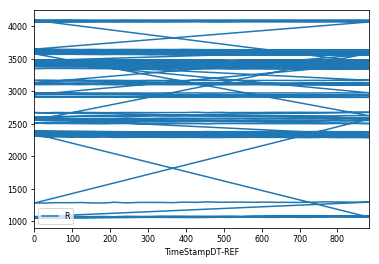

In [154]:
spdf[spdf['SpotID'].plot(x='TimeStampDT-REF',y='R')

In [166]:
spdf['SpotNR'] = spdf['SpotID'].apply(lambda x: '.'.join(x.split('.')[:2]))

In [260]:
os.getcwd()

'M:\\AST-ID-QC\\2018\\IntensityStudy\\Analyte_Response\\Lab_Analyte\\NH3'

In [261]:
spotFiles = miscUtils.getFileList('*spotDF.csv')

In [262]:
spotFiles

['.\\region1_QC_NH3_trial4\\region1_QC_NH3_trial4-spotDF.csv',
 '.\\region1_QC_NH3_trial1\\region1_QC_NH3_trial1-spotDF.csv',
 '.\\region1_QC_NH3_trial3\\region1_QC_NH3_trial3-spotDF.csv',
 '.\\region1_QC_NH3_trial5\\region1_QC_NH3_trial5-spotDF.csv',
 '.\\region1_QC_NH3_trial2\\region1_QC_NH3_trial2-spotDF.csv']

In [263]:
spotFiles[0].split('-spotDF')[0].split('_')[-1]

'trial4'

In [264]:
spdfDict = {}
for f in spotFiles:
    spdf = pandas.read_csv(f)
    spdf['SpotNR'] = spdf['SpotID'].apply(lambda x: '.'.join(x.split('.')[:2]))
    tiral = f.split('-spotDF')[0].split('_')[-1]
    spdfDict[tiral] = spdf

In [516]:
spdfDict['trial1']['SpotNR'].unique()

array(['1.0', '1.1', '11.0', '12.0', '13.0', '14.0', '15.0', '16.0', '2.0',
       '20.0', '26.0', '27.0', '3.0', '4.0', '5.0', '6.0', '7.0', '8.0',
       '81.0', '9.0'], dtype=object)

In [266]:
spdfDict['trial1']['SpotID'].unique()

array(['1.0.100', '1.0.115', '1.0.85', '1.1.100', '1.1.115', '1.1.85',
       '11.0.100', '11.0.115', '11.0.85', '12.0.100', '12.0.115',
       '12.0.85', '13.0.100', '13.0.115', '13.0.85', '14.0.100',
       '14.0.115', '14.0.85', '15.0.100', '15.0.115', '15.0.85',
       '16.0.100', '16.0.115', '16.0.85', '2.0.100', '2.0.115', '2.0.85',
       '20.0.100', '20.0.115', '20.0.85', '26.0.100', '26.0.115',
       '26.0.85', '27.0.100', '27.0.115', '27.0.85', '3.0.100', '3.0.115',
       '3.0.85', '4.0.100', '4.0.115', '4.0.85', '5.0.100', '5.0.115',
       '5.0.85', '6.0.100', '6.0.115', '6.0.85', '7.0.100', '7.0.115',
       '7.0.85', '8.0.100', '8.0.115', '8.0.85', '81.0.100', '81.0.115',
       '81.0.85', '9.0.100', '9.0.115', '9.0.85'], dtype=object)

In [546]:
def plotResponse(spdfDict):
    intensityDict115 = {}
    intensityDict85 = {}
    deltaDict115 = {}
    deltaDict85 = {}
    qcList = []
    colors=['blue','green','red']
    spdf = spdfDict[list(spdfDict.keys())[0]]
    for spot in spdf['SpotNR'].unique():
        fig, ax = plt.subplots(nrows=2,ncols=3,figsize=(15,8))
        for key, value in spdfDict.items():
         #   if key == 'trial4' or key =='trial5':
         #       continue

            for j,c in enumerate(['R','G','B']):
                k = '100'
                subSet = value[value['SpotID'] == spot + '.' +k]
                cRef = subSet[['TimeStampDT-REF',c+'c']].values
                iRef = subSet[['TimeStampDT-REF',c+'i']].values
                for i,k in enumerate(['85','100','115']):
             #   print( spot + '.' +k)
                    subSet = value[value['SpotID'] == spot + '.' +k]   
                    cVal = subSet[['TimeStampDT-REF',c+'c']].values
                    iVal = subSet[['TimeStampDT-REF',c+'i']].values
                    ax[0,j].plot(cVal[:,0],cVal[:,1],color=colors[i])
                    ax[1,j].plot(iVal[:,0],iVal[:,1],color=colors[i])
                    spt = spot + c

                    if i==0:
                        ax[0,j].set_title(' SPOT: ' + spot + c)
    return                    

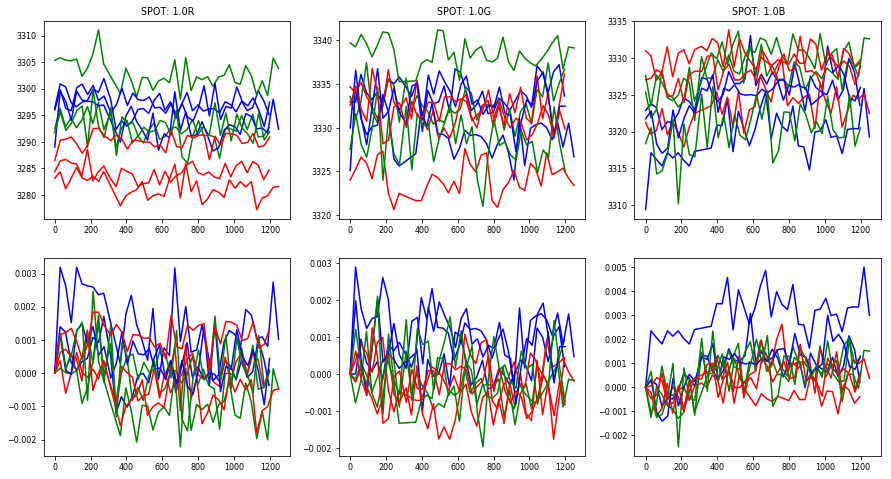

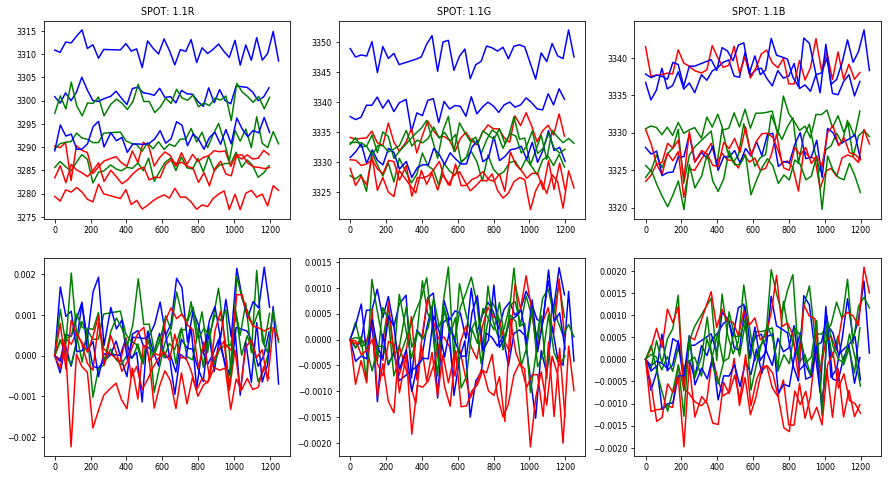

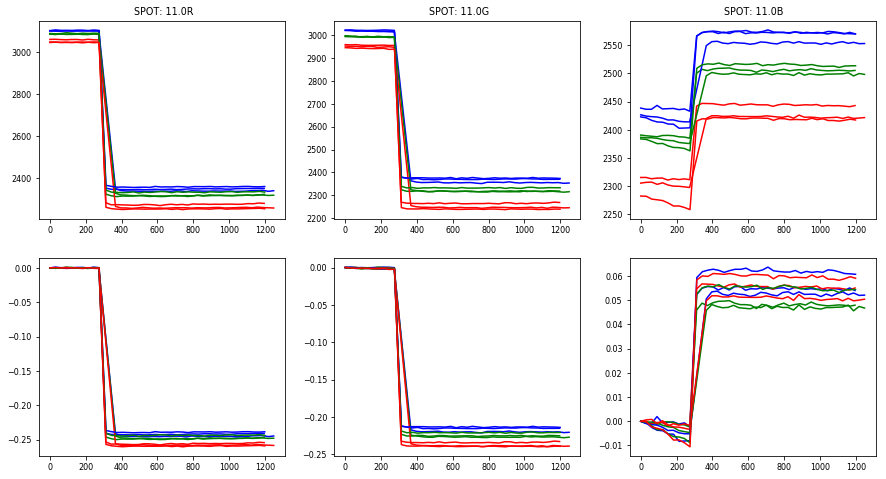

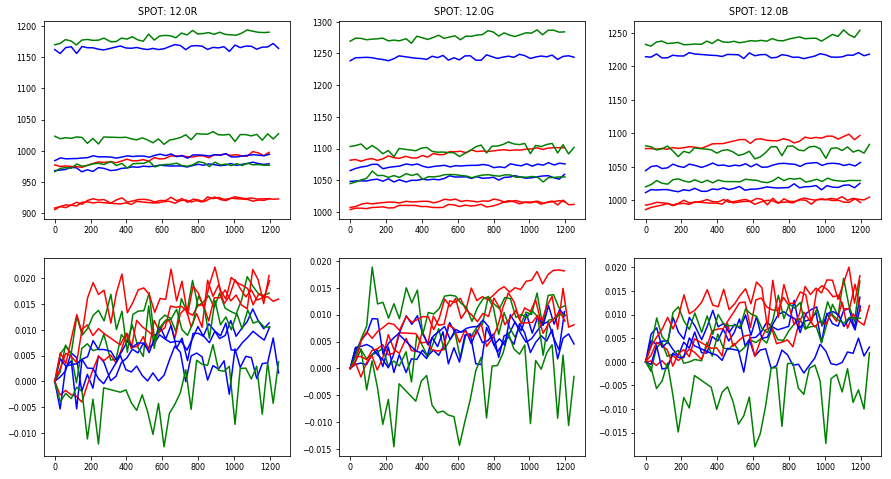

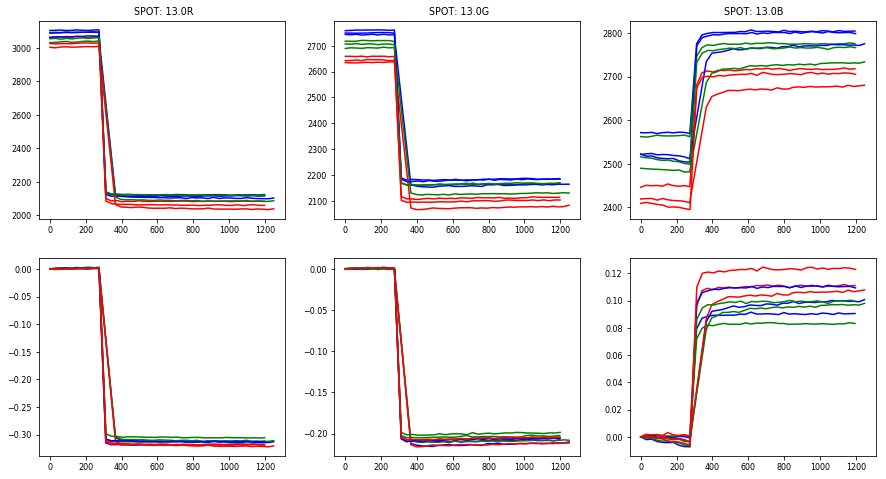

...

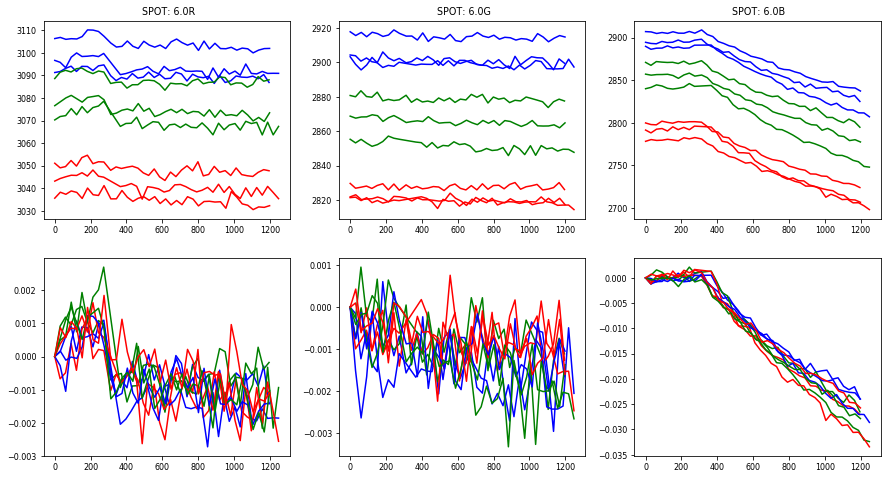

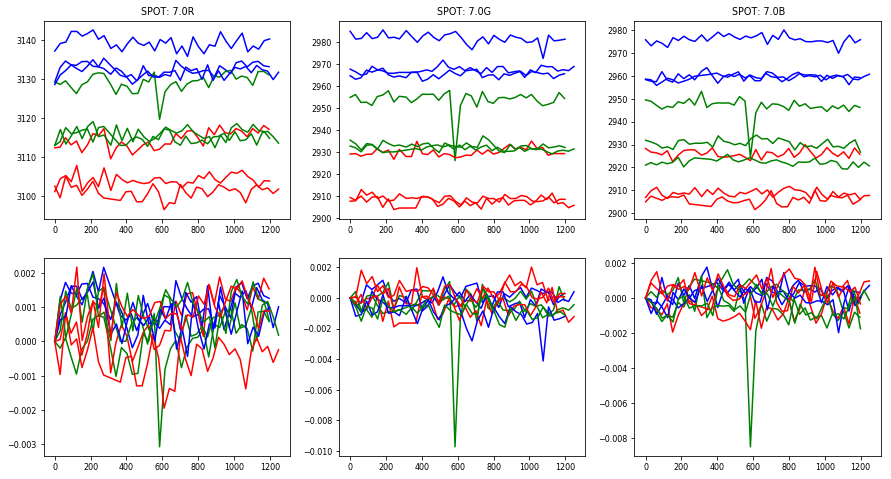

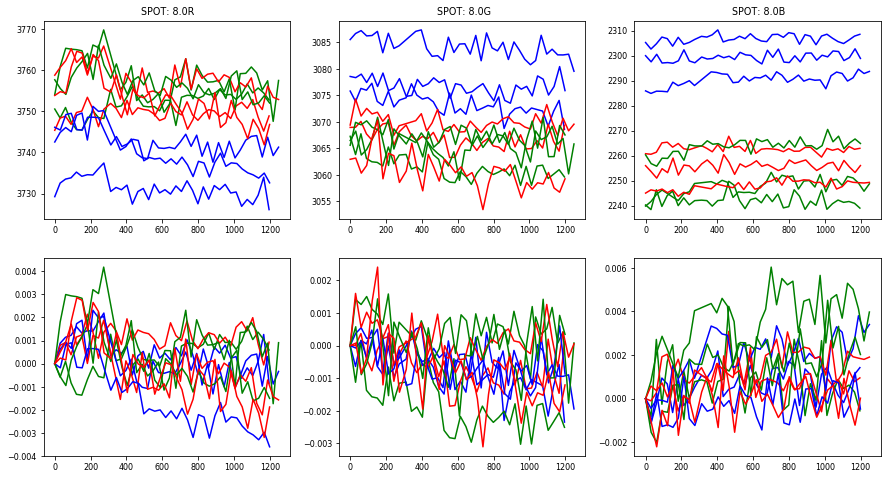

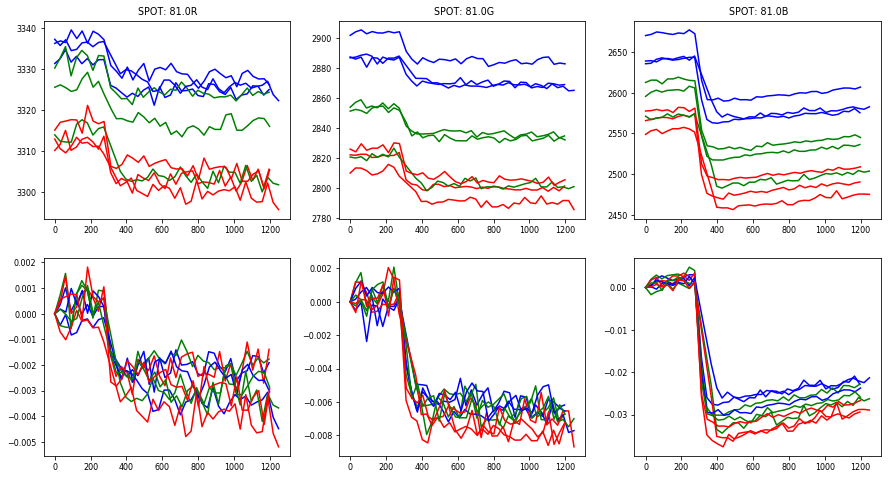

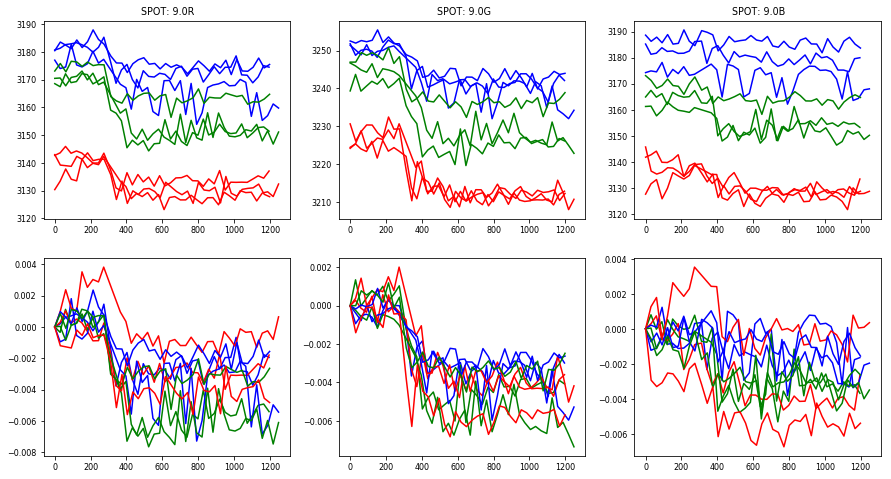

In [528]:
plotResponse(spdfDict)

In [559]:
def analyzeResponse(spdfDict, ignoreTrials = ['trial4','trial5']):
    spot = '15.0'
    intensityDict115 = {}
    intensityDict85 = {}
    deltaDict115 = {}
    deltaDict85 = {}
    qcList = []
    colors=['blue','red']
    endIdx = -2
    for spot in spdf['SpotNR'].unique():
        fig, ax = plt.subplots(nrows=2,ncols=3,figsize=(15,8))
        for key, value in spdfDict.items():
            if key in ignoreTrials:
                continue

            for j,c in enumerate(['R','G','B']):
                k = '100'
                subSet = value[value['SpotID'] == spot + '.' +k]
                cRef = subSet[['TimeStampDT-REF',c+'c']].values
                iRef = subSet[['TimeStampDT-REF',c+'i']].values
                for i,k in enumerate(['85','115']):
             #   print( spot + '.' +k)
                    subSet = value[value['SpotID'] == spot + '.' +k]   
                    cVal = subSet[['TimeStampDT-REF',c+'c']].values
                    iVal = subSet[['TimeStampDT-REF',c+'i']].values
                    ax[0,j].plot(cVal[:endIdx,0],cVal[:endIdx,1]/cRef[:endIdx,1],color=colors[i])
                    ax[1,j].plot(iVal[:endIdx,0],iVal[:endIdx,1]-iRef[:endIdx,1],color=colors[i])
                    spt = spot + c
                    if k=='115':
                        intensityDict115[spt] = cVal[:endIdx,1]/cRef[:endIdx,1]
                        deltaDict115[spt] = iVal[12:endIdx,1]-iRef[12:endIdx,1]
                    else:    
                        intensityDict85[spt] = cVal[:endIdx,1]/cRef[:endIdx,1]
                        deltaDict85[spt] = iVal[12:endIdx,1]-iRef[12:endIdx,1]
                    this={}
                    this['Trial'] = key
                    this['Spot'] = spt
                    this['Conc'] = k
                    this['StdRef'] = np.std(iRef[:endIdx,1])
                    this['IntensityRatio'] = np.mean(cVal[:11,1]/cRef[:11,1])
                    this['DeltaIDifference'] = np.mean(iVal[12:endIdx,1]-iRef[12:endIdx,1])
                    qcList.append(this)
                    #subSet.plot(x='TimeStampDT-REF',y=c+'c', ax=ax[0,j], label=k + '-' + key)
                    #subSet.plot(x='TimeStampDT-REF',y=c+'i', ax=ax[1,j], label=k + '-' + key)
                    if i==0:
                        ax[0,j].set_title(' SPOT: ' + spot + c)
    p1 = pandas.DataFrame(intensityDict115); p1['Conc'] = '115'
    p2 = pandas.DataFrame(intensityDict85); p2['Conc'] = '85'                    
    I = p1.append(p2)
    p1 = pandas.DataFrame(deltaDict115); p1['Conc'] = '115'
    p2 = pandas.DataFrame(deltaDict85); p2['Conc'] = '85'
    D = p1.append(p2)
    allDF = pandas.DataFrame(qcList)
    return allDF, I, D

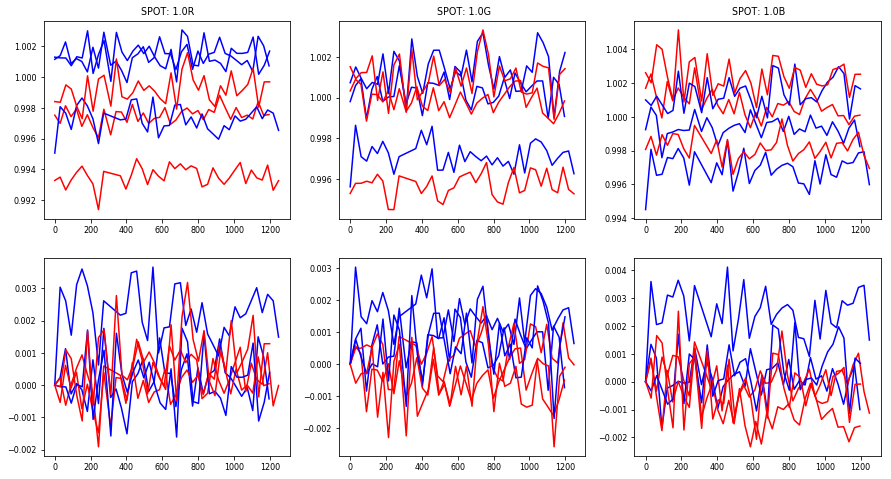

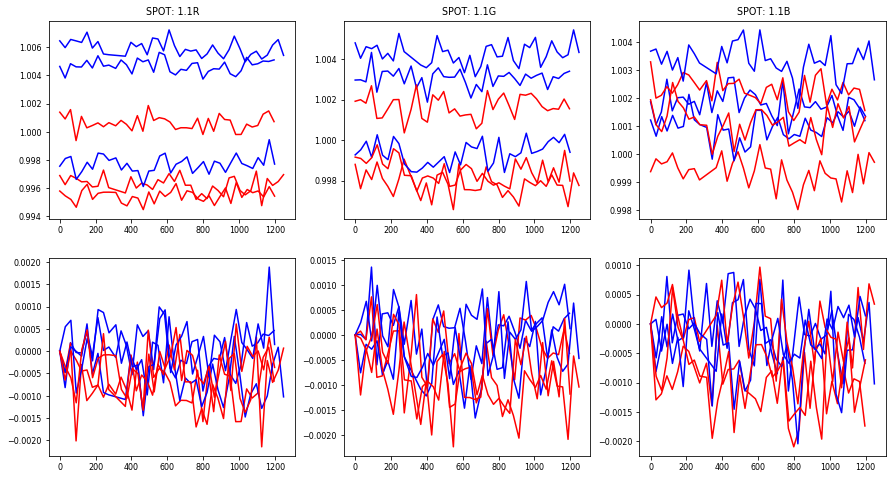

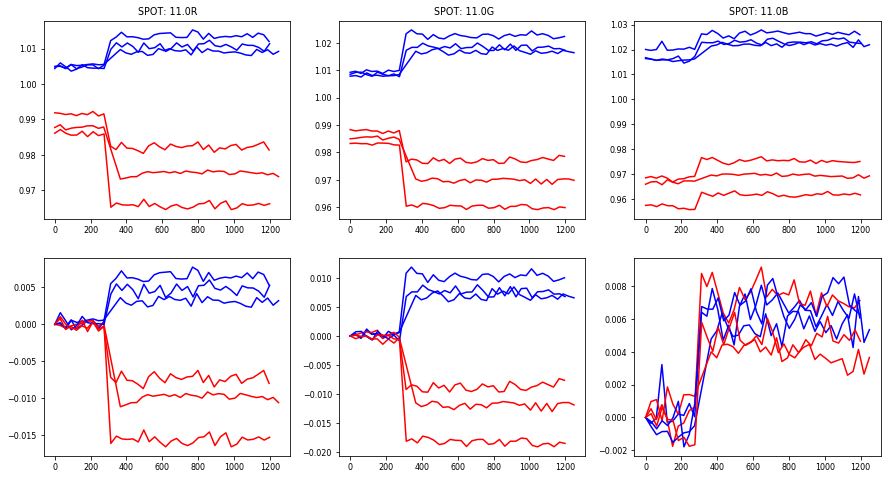

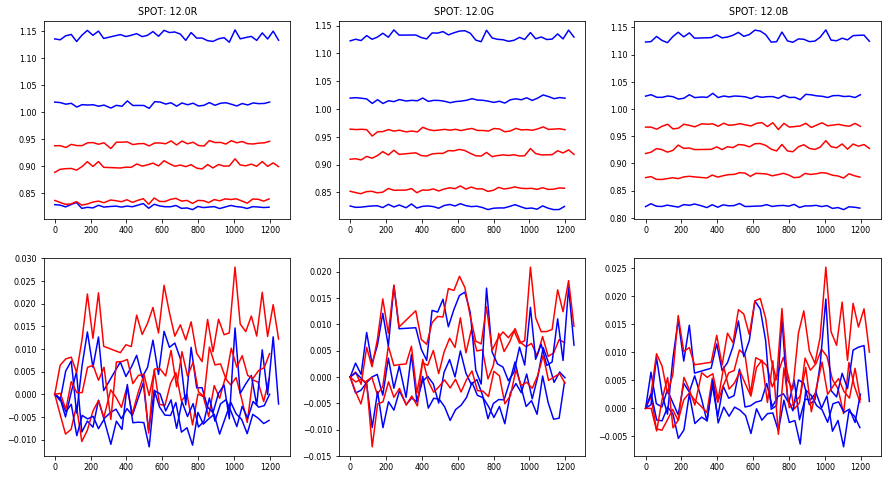

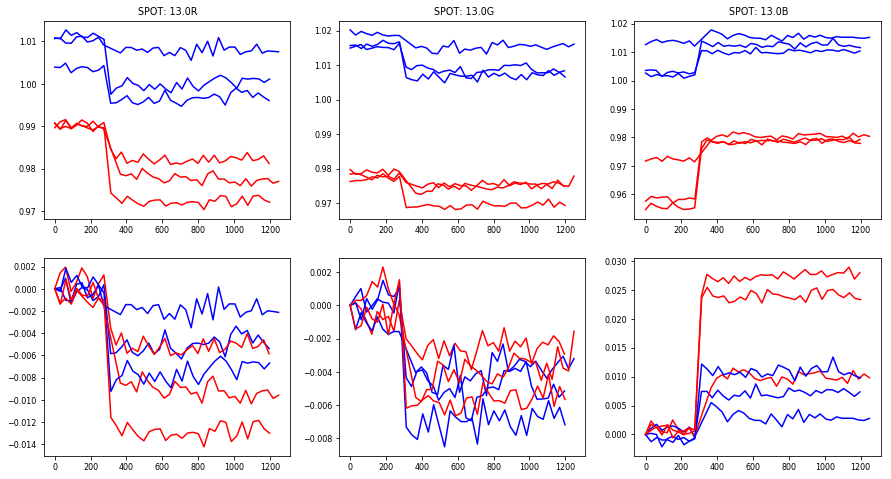

...

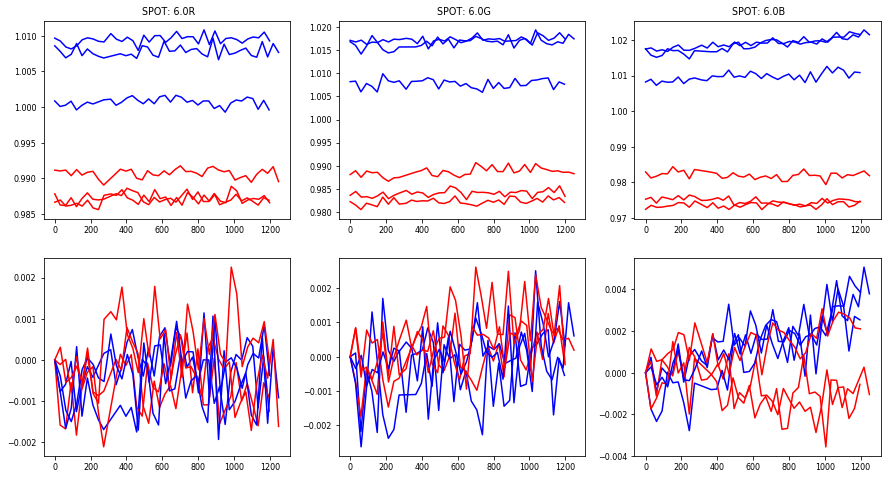

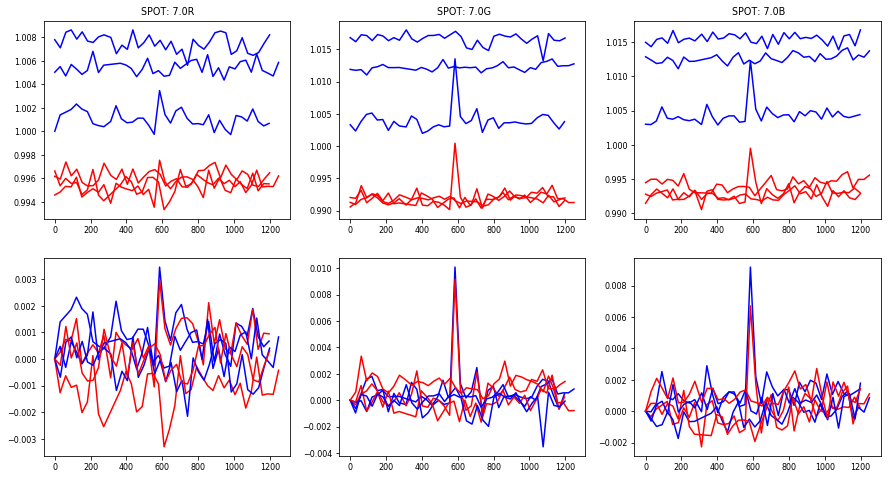

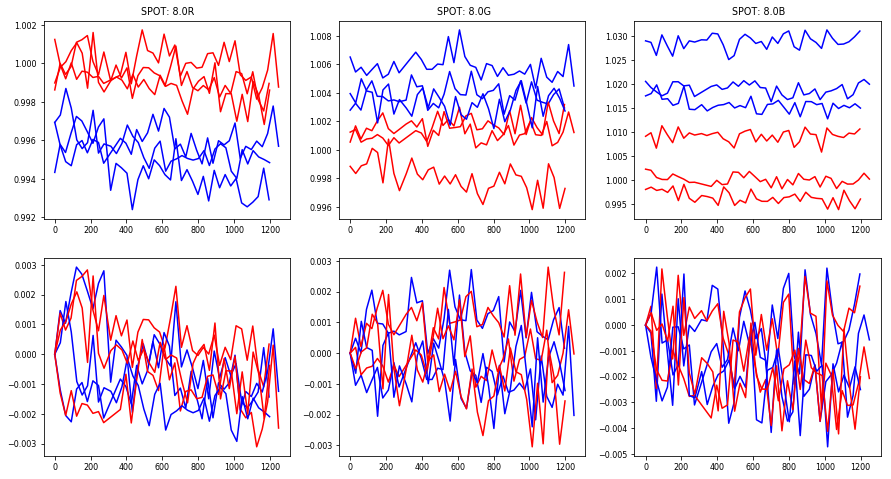

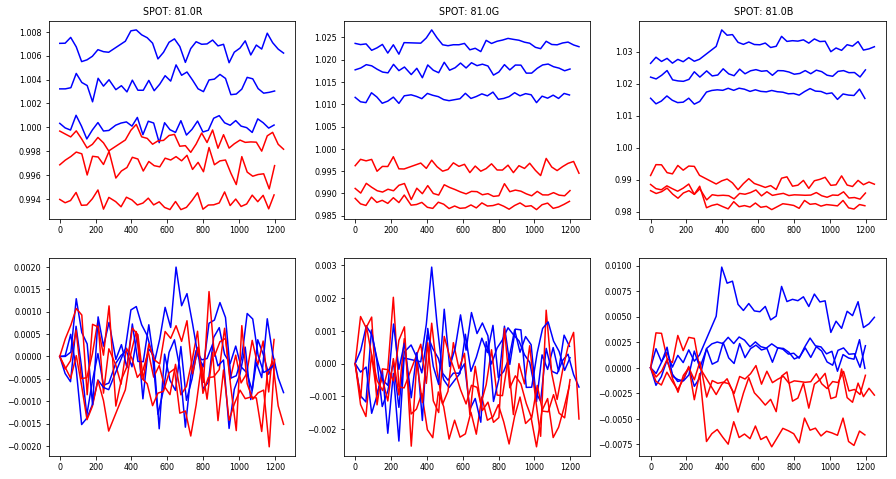

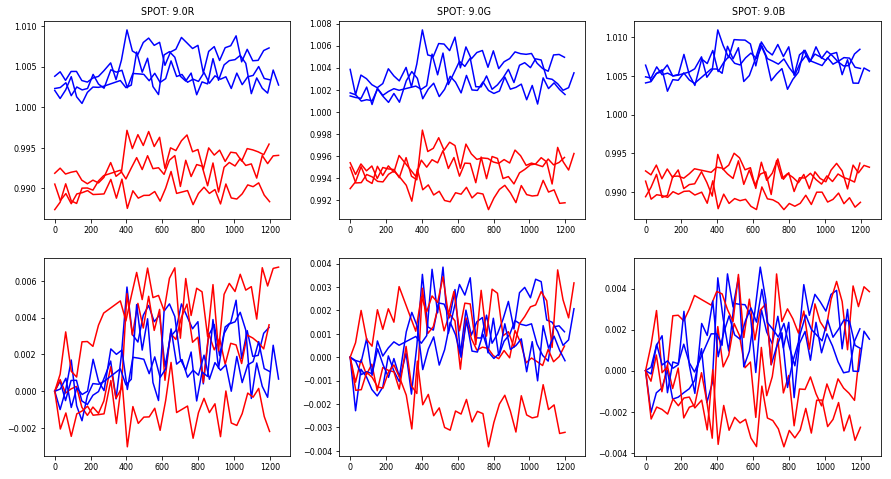

In [530]:
allDF, I, D = analyzeResponse(spdfDict)

In [379]:
p1 = pandas.DataFrame(intensityDict115); p1['Conc'] = '115'
p2 = pandas.DataFrame(intensityDict85); p2['Conc'] = '85'

In [380]:
I = p1.append(p2)

In [381]:
p1 = pandas.DataFrame(deltaDict115); p1['Conc'] = '115'
p2 = pandas.DataFrame(deltaDict85); p2['Conc'] = '85'

In [382]:
D = p1.append(p2)

In [383]:
I.head()

,1.0B,1.0G,1.0R,1.1B,1.1G,1.1R,11.0B,11.0G,11.0R,12.0B,...,8.0B,8.0G,8.0R,81.0B,81.0G,81.0R,9.0B,9.0G,9.0R,Conc
0,1.002621,1.001514,0.998411,1.001932,0.999162,0.995792,0.957501,0.983272,0.986104,0.966660,...,0.998094,0.998844,0.998986,0.986578,0.991118,0.996860,0.991372,0.994975,0.990509,115
1,1.002028,1.000925,0.998367,1.001037,0.999097,0.995447,0.957722,0.983390,0.987139,0.966656,...,0.998573,0.998343,0.999795,0.985688,0.990078,0.997254,0.989037,0.993569,0.988480,115
2,1.004278,1.001225,0.999497,1.000795,0.998855,0.995197,0.956999,0.983197,0.986087,0.962790,...,0.997891,0.998883,1.000093,0.986259,0.992262,0.997558,0.989612,0.993597,0.989342,115
3,1.004012,1.001232,0.999228,1.001352,0.999131,0.994642,0.958086,0.983228,0.985543,0.968170,...,0.998137,0.999018,1.000668,0.987379,0.991381,0.997928,0.989498,0.994332,0.988087,115
4,1.002315,1.002047,0.998085,1.002549,0.999770,0.995824,0.957384,0.982687,0.985598,0.971946,...,0.997477,1.000108,1.001077,0.985505,0.990600,0.997783,0.989276,0.994118,0.989296,115


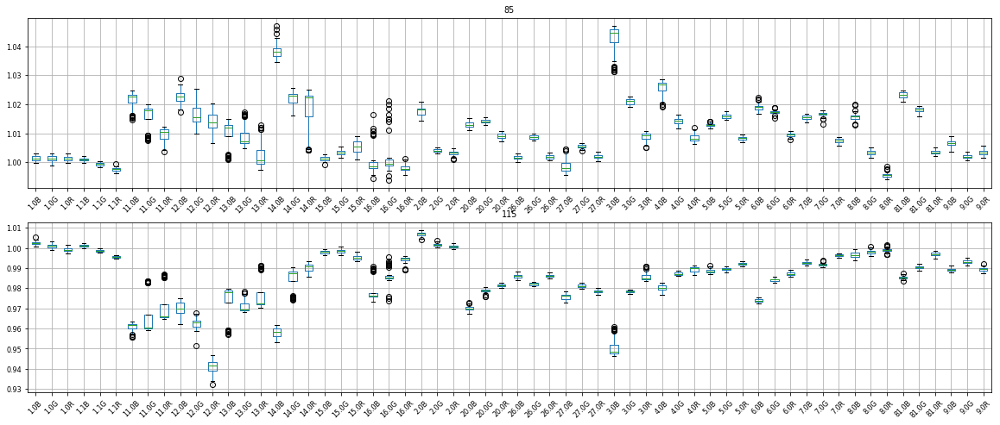

In [384]:
fig, ax = plt.subplots(nrows=2,ncols=1,figsize=(20,8))
for i,c in enumerate(['85','115']):
    I[I['Conc']==c].boxplot(ax=ax[i])
    ax[i].set_title(c)
    for tick in ax[i].get_xticklabels():
        tick.set_rotation(45)


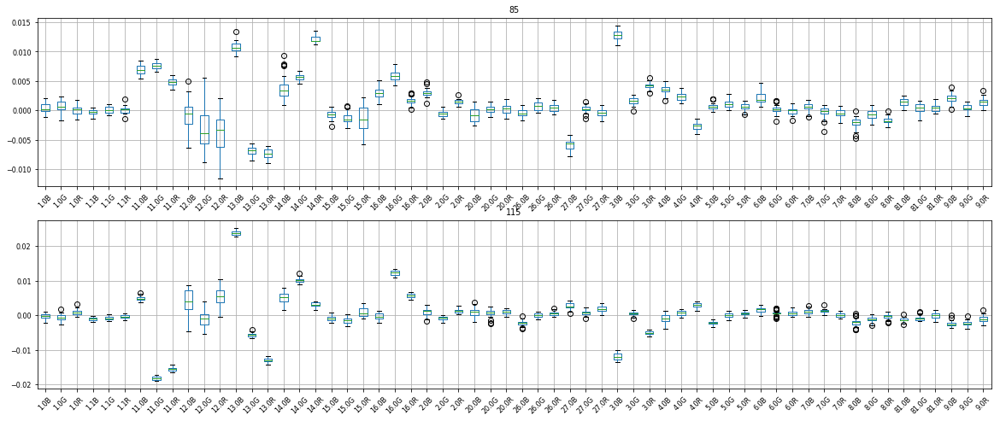

In [385]:
fig, ax = plt.subplots(nrows=2,ncols=1,figsize=(20,8))
for i,c in enumerate(['85','115']):
    D[D['Conc']==c].boxplot(ax=ax[i])
    ax[i].set_title(c)
    for tick in ax[i].get_xticklabels():
        tick.set_rotation(45)
        

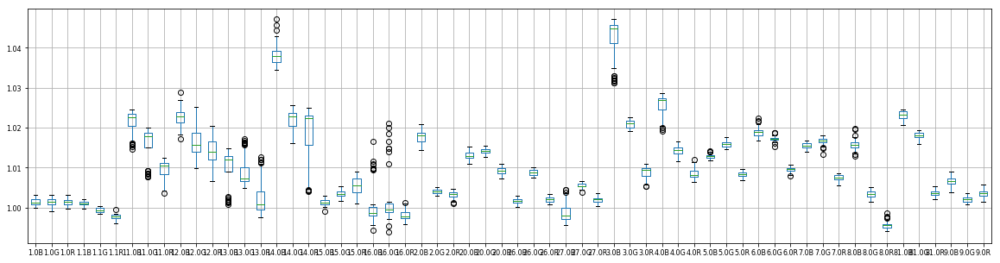

In [386]:
I[I['Conc']=='85'].boxplot(figsize=(20,5))

In [387]:
import seaborn

In [434]:
allDF = pandas.DataFrame(qcList)

In [435]:
allDF.head()

,Conc,DeltaIDifference,IntensityRatio,Spot,StdRef,Trial
0,85,0.000181,1.001322,1.0R,0.000628,trial1
1,115,0.000097,0.997208,1.0R,0.000628,trial1
2,85,0.000567,1.000261,1.0G,0.000597,trial1
3,115,-0.000534,1.000031,1.0G,0.000597,trial1
4,85,0.000090,0.999354,1.0B,0.000736,trial1


(0.8, 1.1)

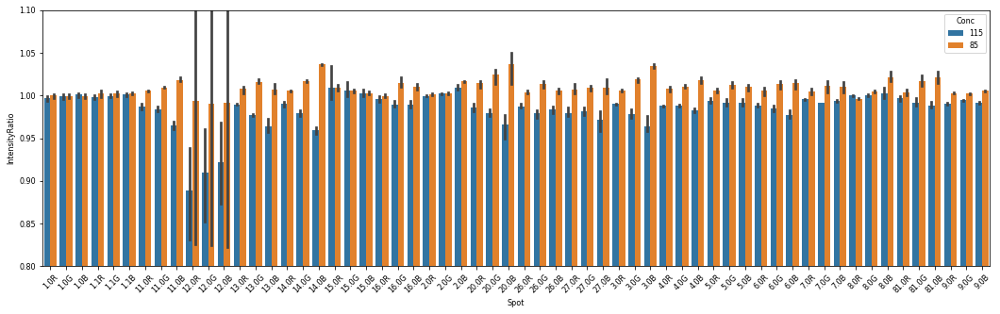

In [390]:
fig,ax = plt.subplots(figsize=(18,5))
seaborn.barplot(data=allDF, hue='Conc', x='Spot', y='IntensityRatio', ax=ax)
plt.xticks(rotation='45')
ax.set_ylim([0.8,1.1])

(0.8, 1.1)

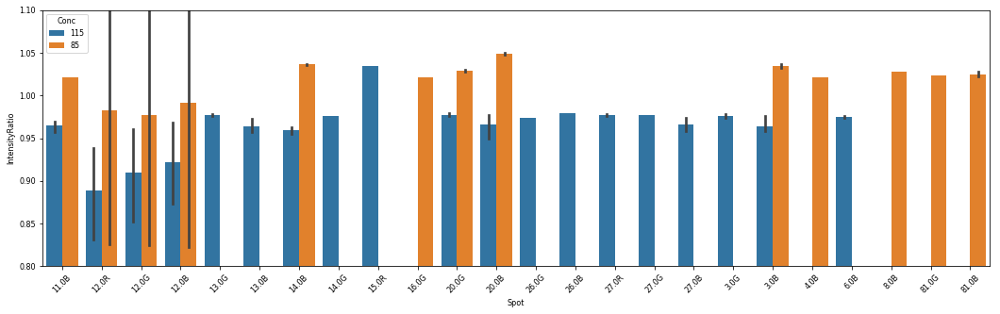

In [391]:
fig,ax = plt.subplots(figsize=(18,5))
seaborn.barplot(data=allDF[np.abs(allDF['IntensityRatio']-1)>0.02], hue='Conc', x='Spot', y='IntensityRatio', ax=ax)
plt.xticks(rotation='45')
ax.set_ylim([0.8,1.1])

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
        51, 52, 53, 54, 55, 56, 57, 58, 59]),
 <a list of 60 Text xticklabel objects>)

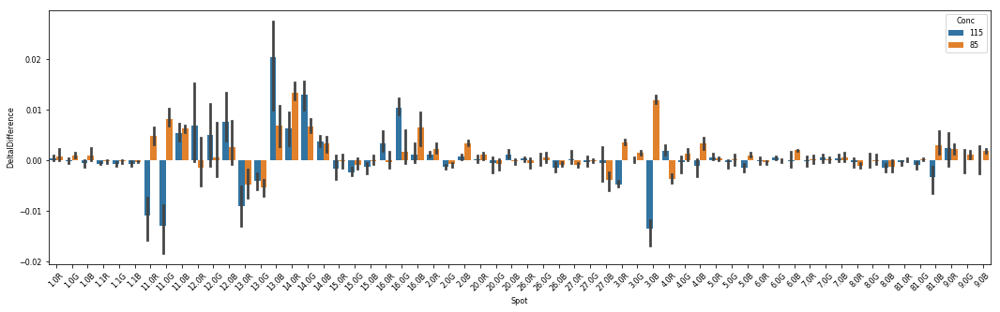

In [392]:
fig,ax = plt.subplots(figsize=(18,5))
seaborn.barplot(data=allDF, hue='Conc', x='Spot', y='DeltaIDifference', ax=ax)
plt.xticks(rotation='45')
#ax.set_ylim([0.8,1.1])

(array([0, 1, 2, 3, 4, 5, 6, 7, 8]), <a list of 9 Text xticklabel objects>)

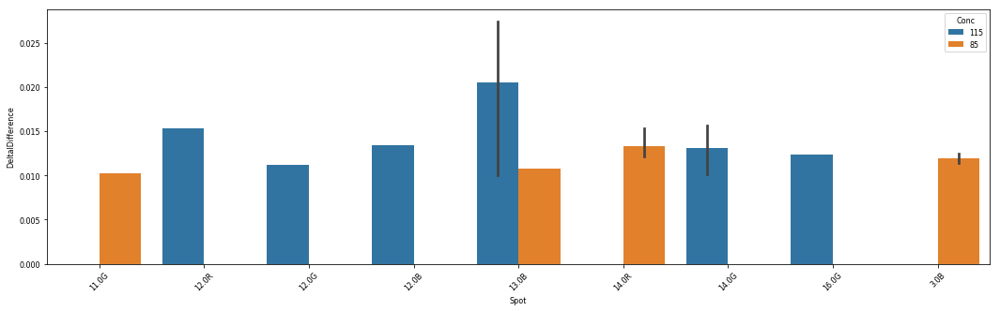

In [395]:
fig,ax = plt.subplots(figsize=(18,5))
seaborn.barplot(data=allDF[np.abs(allDF['DeltaIDifference']>0.01)], hue='Conc', x='Spot', y='DeltaIDifference', ax=ax)
plt.xticks(rotation='45')

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
        51, 52, 53, 54, 55, 56, 57, 58, 59]),
 <a list of 60 Text xticklabel objects>)

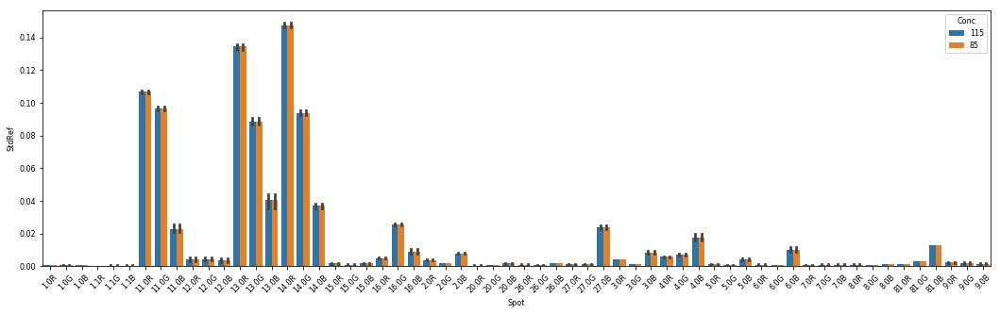

In [436]:
fig,ax = plt.subplots(figsize=(18,5))
#ax.set( yscale="log")
#allDF['StdRef'] = np.sqrt(allDF['StdRef'])
seaborn.barplot(data=allDF, hue='Conc', x='Spot', y='StdRef', ax=ax)
plt.xticks(rotation='45')
#ax.set_yscale('log')

In [438]:
allDF[allDF['StdRef']>0.01].pivot_table(index=['Conc','Spot'],columns='Trial',values='StdRef')

Trial         trial1    trial2    trial3
Conc Spot                               
115  11.0B  0.021251  0.025733  0.021265
     11.0G  0.097464  0.095253  0.097656
     11.0R  0.107650  0.105620  0.107387
     13.0B  0.035567  0.044094  0.041543
     13.0G  0.088406  0.086518  0.090940
     13.0R  0.135873  0.132387  0.135245
     14.0B  0.035716  0.038577  0.036458
     14.0G  0.093521  0.092289  0.095684
     14.0R  0.146858  0.146141  0.149300
     16.0B       NaN  0.010493       NaN
     16.0G  0.025065  0.025833  0.026383
     27.0B  0.024927  0.023693  0.022705
     4.0B   0.019690  0.016095  0.017563
     6.0B        NaN       NaN  0.011578
     81.0B  0.012715  0.012917  0.013052
85   11.0B  0.021251  0.025733  0.021265
     11.0G  0.097464  0.095253  0.097656
     11.0R  0.107650  0.105620  0.107387
     13.0B  0.035567  0.044094  0.041543
     13.0G  0.088406  0.086518  0.090940
     13.0R  0.135873  0.132387  0.135245
     14.0B  0.035716  0.038577  0.036458
     14.0G  0.093521  0.092289  0.095684
     14.0R  0.146858  0.146141  0.149300
     16.0B       NaN  0.010493       NaN
     16.0G  0.025065  0.025833  0.026383
     27.0B  0.024927  0.023693  0.022705
     4.0B   0.019690  0.016095  0.017563
     6.0B        NaN       NaN  0.011578
     81.0B  0.012715  0.012917  0.013052

In [425]:
allDF[allDF['Spot'] == '2.0R']

,Conc,DeltaIDifference,IntensityRatio,Spot,StdRef,Trial
144,85,0.003452,1.000112,2.0R,184.068378,trial1
145,115,0.000777,0.999121,2.0R,184.068378,trial1
150,85,0.002141,1.001371,2.0R,180.509948,trial3
151,115,0.001694,0.998845,2.0R,180.509948,trial3
156,85,0.001441,1.002167,2.0R,152.988732,trial2
157,115,0.001256,1.000348,2.0R,152.988732,trial2


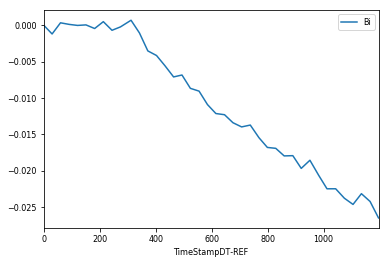

In [441]:
value = spdfDict['trial1']
value[value['SpotID'] == '6.0.100'].plot(x='TimeStampDT-REF',y='Bi')

In [444]:
d = value[value['SpotID'] == '6.0.100'][['TimeStampDT-REF','Bi']].values

In [447]:
np.std(d[:,1])

0.0089446485653908829

In [424]:
allDF['Spot'].unique()

array(['1.0R', '1.0G', '1.0B', '1.1R', '1.1G', '1.1B', '11.0R', '11.0G',
       '11.0B', '12.0R', '12.0G', '12.0B', '13.0R', '13.0G', '13.0B',
       '14.0R', '14.0G', '14.0B', '15.0R', '15.0G', '15.0B', '16.0R',
       '16.0G', '16.0B', '2.0R', '2.0G', '2.0B', '20.0R', '20.0G', '20.0B',
       '26.0R', '26.0G', '26.0B', '27.0R', '27.0G', '27.0B', '3.0R',
       '3.0G', '3.0B', '4.0R', '4.0G', '4.0B', '5.0R', '5.0G', '5.0B',
       '6.0R', '6.0G', '6.0B', '7.0R', '7.0G', '7.0B', '8.0R', '8.0G',
       '8.0B', '81.0R', '81.0G', '81.0B', '9.0R', '9.0G', '9.0B'], dtype=object)

In [577]:
def categorize(row):
  #  print(row)
    cat = ''
    if row['StdRef'] < 0.01 :
        cat = 'CAT5'
    elif np.abs(row['IntensityRatio']-1)>0.02 :
        # Intensity Different
         if np.abs(row['DeltaIDifference'])>0.01   :
             # Delta I different
            cat = 'CAT1'
         else:
            cat = 'CAT2'
    else:
       if np.abs(row['DeltaIDifference'])>0.01   :
           cat = 'CAT4'
       else:
           cat = 'CAT3'
    return cat        

In [507]:
allDF['CAT'] = allDF.apply(lambda x: categorize(x),axis=1)

Conc                         85
DeltaIDifference    0.000181418
IntensityRatio          1.00132
Spot                       1.0R
StdRef              0.000627607
Trial                    trial1
CAT                        CAT5
Name: 0, dtype: object
Conc                        115
DeltaIDifference    9.67186e-05
IntensityRatio         0.997208
Spot                       1.0R
StdRef              0.000627607
Trial                    trial1
CAT                        CAT5
Name: 1, dtype: object
Conc                         85
DeltaIDifference    0.000567139
IntensityRatio          1.00026
Spot                       1.0G
StdRef              0.000597139
Trial                    trial1
CAT                        CAT5
Name: 2, dtype: object
Conc                        115
DeltaIDifference   -0.000534077
IntensityRatio          1.00003
Spot                       1.0G
StdRef              0.000597139
Trial                    trial1
CAT                        CAT5
Name: 3, dtype: object
Conc        

Conc                       115
DeltaIDifference   -0.00106048
IntensityRatio        0.960686
Spot                     12.0G
StdRef              0.00347207
Trial                   trial2
CAT                       CAT5
Name: 69, dtype: object
Conc                         85
DeltaIDifference   -0.000636037
IntensityRatio          1.02242
Spot                      12.0B
StdRef               0.00268417
Trial                    trial2
CAT                        CAT5
Name: 70, dtype: object
Conc                       115
DeltaIDifference    0.00399469
IntensityRatio        0.967821
Spot                     12.0B
StdRef              0.00268417
Trial                   trial2
CAT                       CAT5
Name: 71, dtype: object
Conc                        85
DeltaIDifference   -0.00498372
IntensityRatio         1.00296
Spot                     13.0R
StdRef                0.135873
Trial                   trial1
CAT                       CAT5
Name: 72, dtype: object
Conc                       11

In [508]:
allDF.head()

,Conc,DeltaIDifference,IntensityRatio,Spot,StdRef,Trial,CAT
0,85,0.000181,1.001322,1.0R,0.000628,trial1,CAT5
1,115,0.000097,0.997208,1.0R,0.000628,trial1,CAT5
2,85,0.000567,1.000261,1.0G,0.000597,trial1,CAT5
3,115,-0.000534,1.000031,1.0G,0.000597,trial1,CAT5
4,85,0.000090,0.999354,1.0B,0.000736,trial1,CAT5


In [509]:
allDF[allDF['CAT']!='CAT5'].groupby(['Conc','CAT','Spot']).count()

DeltaIDifference  IntensityRatio  StdRef  Trial
Conc CAT  Spot                                                  
115  CAT1 13.0B                 3               3       3      3
          14.0G                 1               1       1      1
     CAT2 11.0B                 3               3       3      3
          13.0G                 3               3       3      3
          14.0B                 3               3       3      3
          27.0B                 2               2       2      2
     CAT3 11.0G                 3               3       3      3
          11.0R                 3               3       3      3
          13.0R                 3               3       3      3
          14.0R                 3               3       3      3
          16.0B                 1               1       1      1
          16.0G                 2               2       2      2
          27.0B                 1               1       1      1
          4.0B                  3               3       3      3
          6.0B                  1               1       1      1
          81.0B                 3               3       3      3
     CAT4 14.0G                 2               2       2      2
          16.0G                 1               1       1      1
85   CAT2 11.0B                 1               1       1      1
          14.0B                 3               3       3      3
          16.0G                 1               1       1      1
          4.0B                  1               1       1      1
          81.0B                 2               2       2      2
     CAT3 11.0B                 2               2       2      2
          11.0G                 2               2       2      2
          11.0R                 3               3       3      3
          13.0B                 2               2       2      2
          13.0G                 3               3       3      3
          13.0R                 3               3       3      3
          14.0G                 3               3       3      3
          16.0B                 1               1       1      1
          16.0G                 2               2       2      2
          27.0B                 3               3       3      3
          4.0B                  2               2       2      2
          6.0B                  1               1       1      1
          81.0B                 1               1       1      1
     CAT4 11.0G                 1               1       1      1
          13.0B                 1               1       1      1
          14.0R                 3               3       3      3

In [486]:
pandas.DataFrame(allDF.groupby(['Conc','CAT'])['Trial'].count()).pivot_table(index='Conc',columns='CAT')

Trial                  
CAT   CAT1  CAT2 CAT4   CAT5
Conc                        
115    4.0  11.0  3.0  162.0
85     NaN   8.0  5.0  167.0

In [488]:
allDF.head()

,Conc,DeltaIDifference,IntensityRatio,Spot,StdRef,Trial,CAT
0,85,0.000181,1.001322,1.0R,0.000628,trial1,CAT5
1,115,0.000097,0.997208,1.0R,0.000628,trial1,CAT5
2,85,0.000567,1.000261,1.0G,0.000597,trial1,CAT5
3,115,-0.000534,1.000031,1.0G,0.000597,trial1,CAT5
4,85,0.000090,0.999354,1.0B,0.000736,trial1,CAT5


In [489]:
allDF_MEAN = allDF.groupby(['Conc','Spot']).mean()

In [503]:
allDF_MEAN['CAT'] = allDF_MEAN.apply(lambda x: categorize(x),axis=1)

DeltaIDifference   -0.000537477
IntensityRatio          1.00086
StdRef               0.00087965
CAT                        CAT5
Name: (115, 1.0B), dtype: object
DeltaIDifference    -0.00019531
IntensityRatio         0.998864
StdRef              0.000632596
CAT                        CAT5
Name: (115, 1.0G), dtype: object
DeltaIDifference    0.000473245
IntensityRatio         0.996437
StdRef              0.000767714
CAT                        CAT5
Name: (115, 1.0R), dtype: object
DeltaIDifference    -0.00071244
IntensityRatio          1.00115
StdRef              0.000556467
CAT                        CAT5
Name: (115, 1.1B), dtype: object
DeltaIDifference   -0.000744116
IntensityRatio         0.999576
StdRef              0.000488068
CAT                        CAT5
Name: (115, 1.1G), dtype: object
DeltaIDifference   -0.000603722
IntensityRatio         0.997546
StdRef              0.000505233
CAT                        CAT5
Name: (115, 1.1R), dtype: object
DeltaIDifference     0.005337
Inte

In [515]:
allDF_MEAN[(allDF_MEAN['CAT']=='CAT1') | (allDF_MEAN['CAT'] == 'CAT4')].groupby(['Conc','CAT','Spot']).sum()

DeltaIDifference  IntensityRatio    StdRef
Conc CAT  Spot                                             
115  CAT1 13.0B          0.020460        0.963485  0.040401
          14.0G          0.013070        0.979518  0.093831
     CAT4 16.0G          0.010374        0.989633  0.025760
85   CAT4 14.0R          0.013308        1.005351  0.147433

In [511]:
allDF[allDF['Spot'] == '14.0R']

,Conc,DeltaIDifference,IntensityRatio,Spot,StdRef,Trial,CAT
90,85,0.015352,1.004851,14.0R,0.146858,trial1,CAT4
91,115,0.009426,0.992384,14.0R,0.146858,trial1,CAT3
96,85,0.012475,1.005207,14.0R,0.149300,trial3,CAT4
97,115,0.006536,0.990620,14.0R,0.149300,trial3,CAT3
102,85,0.012097,1.005997,14.0R,0.146141,trial2,CAT4
103,115,0.003093,0.987064,14.0R,0.146141,trial2,CAT3


In [512]:
allDF[allDF['Spot'] == '16.0G']

,Conc,DeltaIDifference,IntensityRatio,Spot,StdRef,Trial,CAT
128,85,-0.000478,1.013097,16.0G,0.025065,trial1,CAT3
129,115,0.009057,0.988020,16.0G,0.025065,trial1,CAT3
134,85,-0.000399,1.020736,16.0G,0.026383,trial3,CAT2
135,115,0.009740,0.993443,16.0G,0.026383,trial3,CAT3
140,85,0.005951,1.010638,16.0G,0.025833,trial2,CAT3
141,115,0.012324,0.987436,16.0G,0.025833,trial2,CAT4


# Analyze NH3

In [584]:
os.chdir('../NH3/')
os.getcwd()

'M:\\AST-ID-QC\\2018\\IntensityStudy\\Analyte_Response\\Lab_Analyte\\NH3'

C:\Anaconda3\lib\site-packages\matplotlib\pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


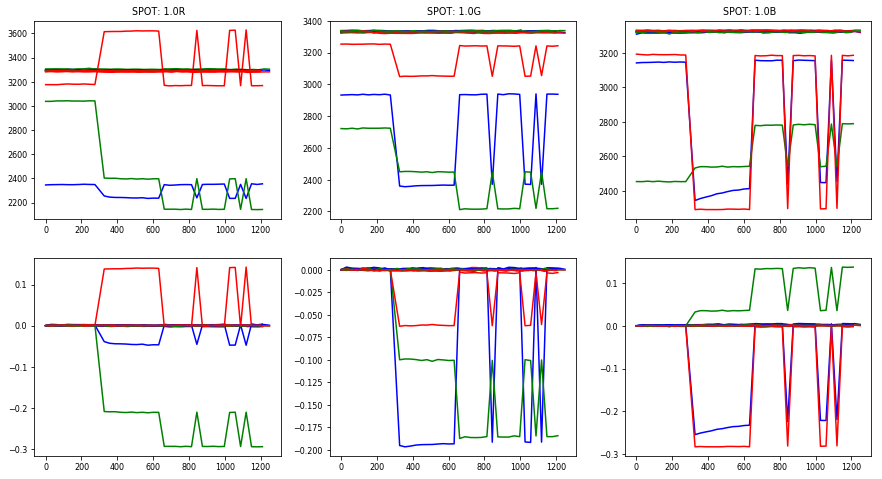

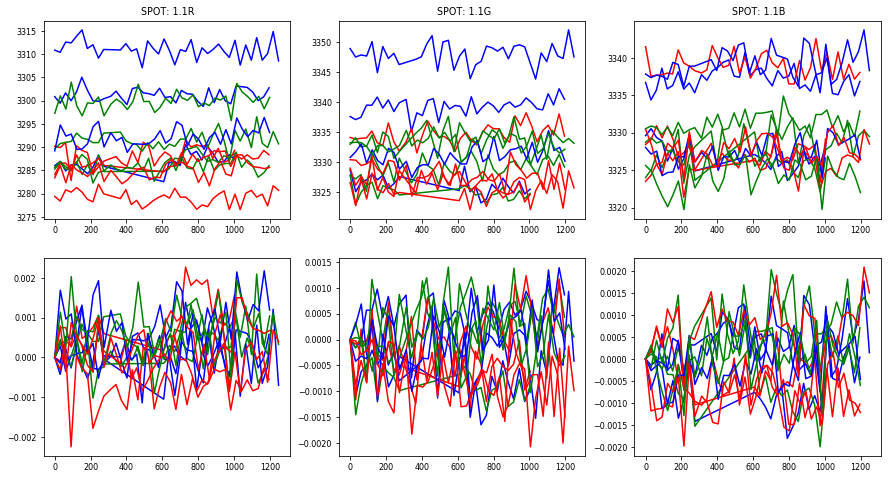

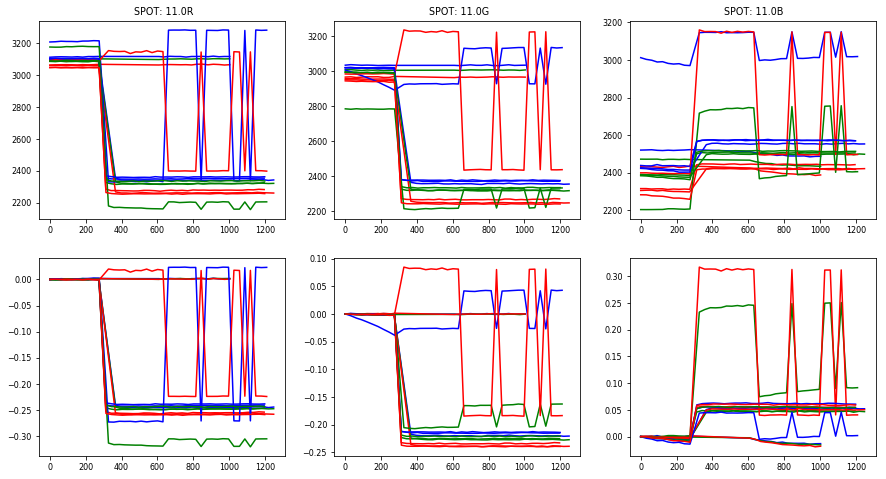

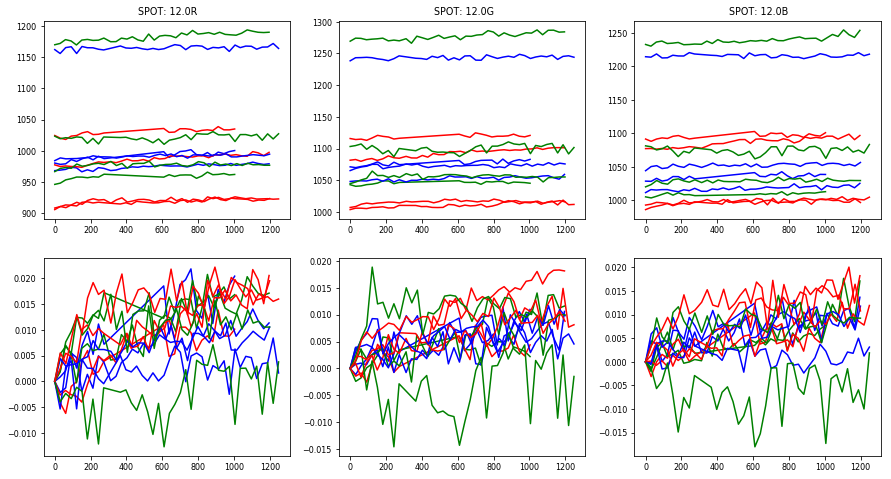

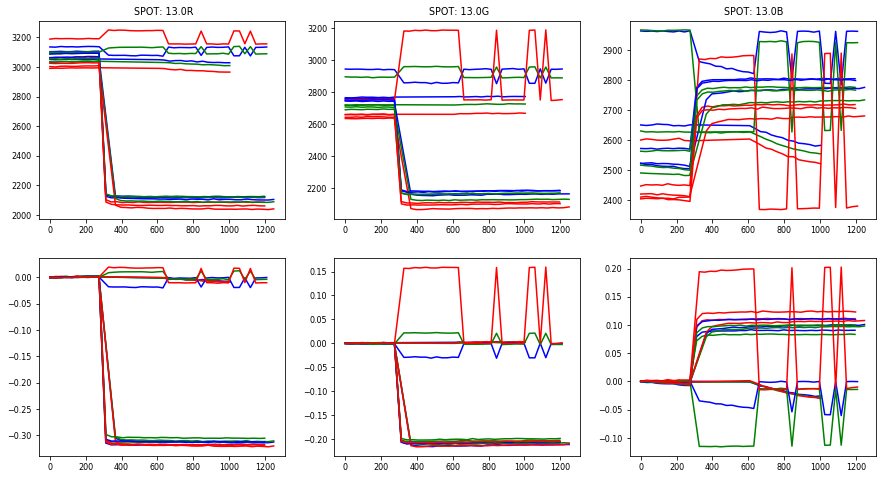

...

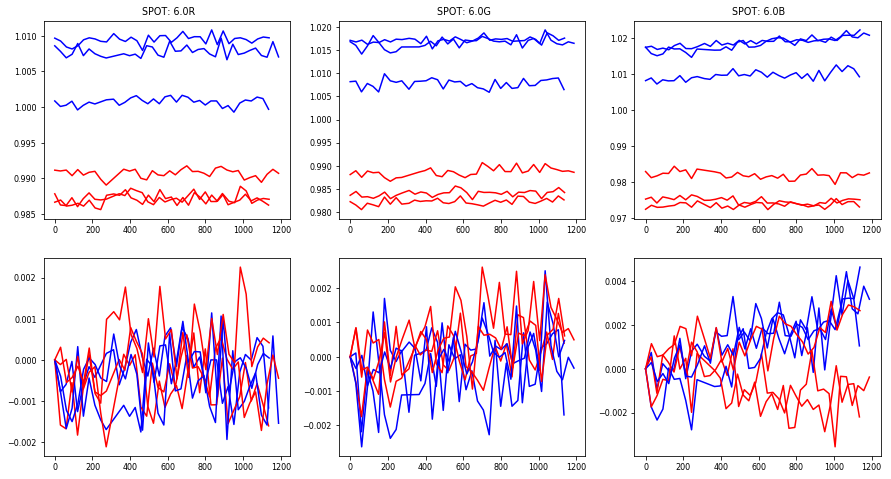

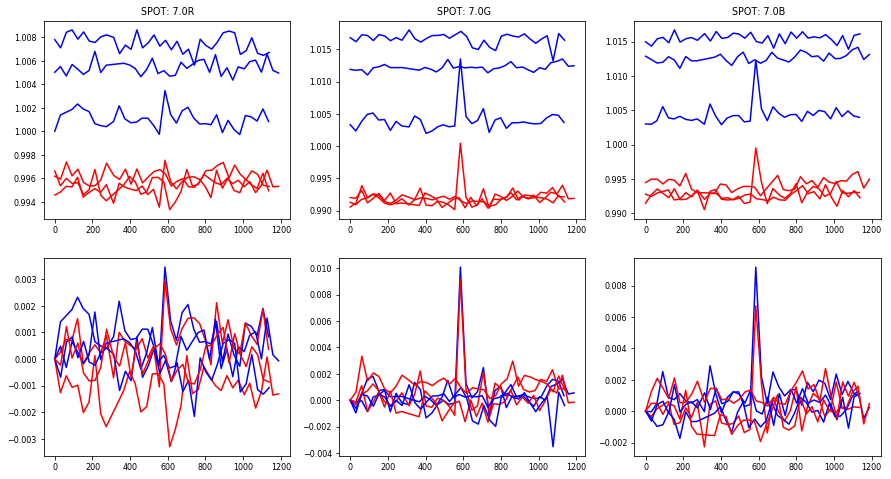

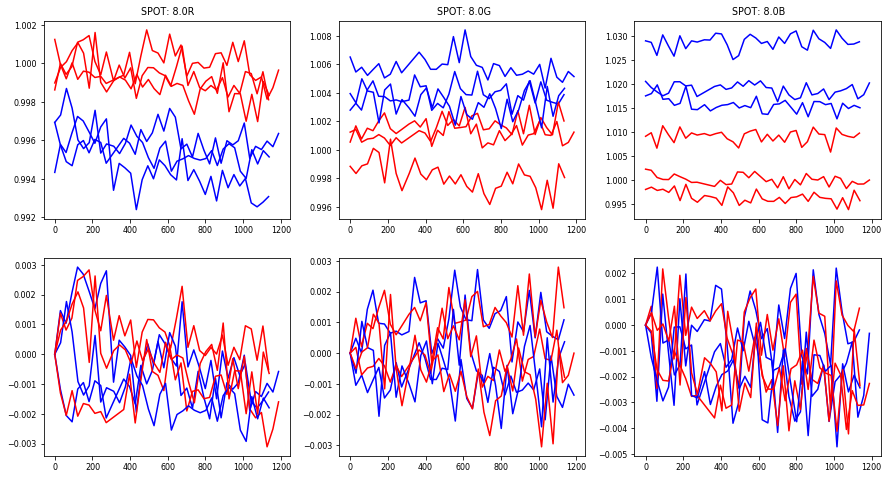

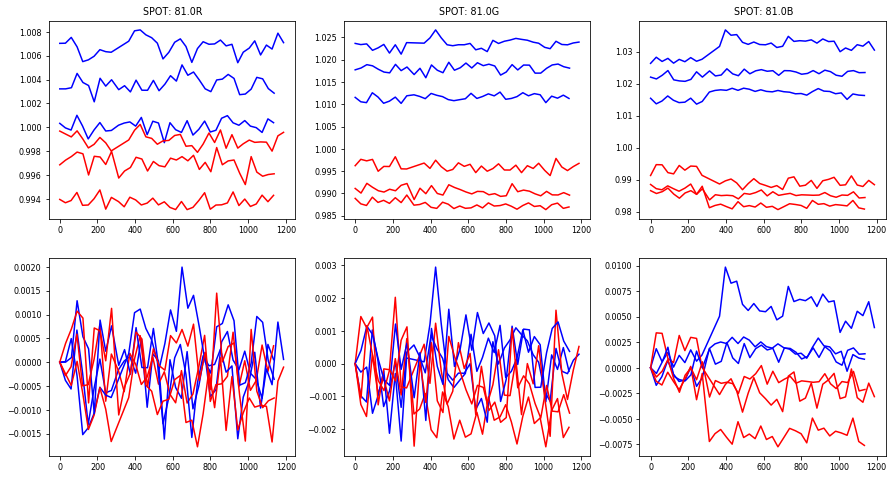

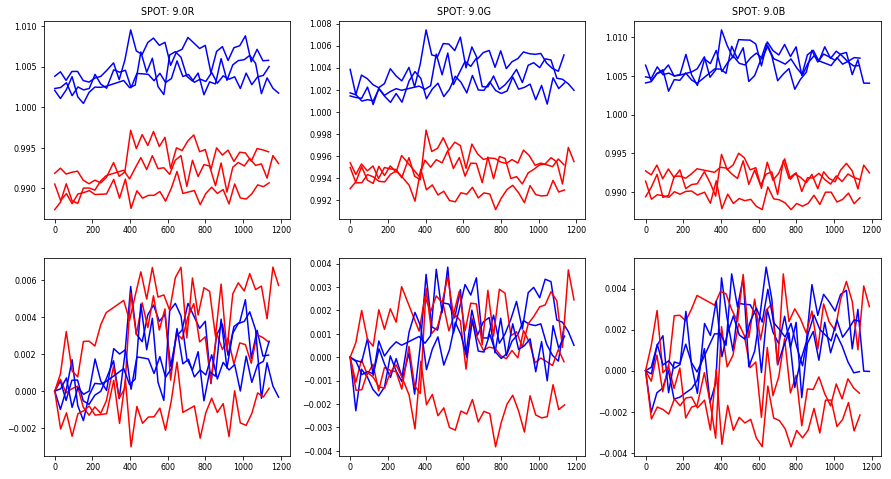

In [585]:
# Read in All Data
spotFiles = miscUtils.getFileList('*spotDF.csv')
spdfDict = {}
for f in spotFiles:
    spdf = pandas.read_csv(f)
    spdf['SpotNR'] = spdf['SpotID'].apply(lambda x: '.'.join(x.split('.')[:2]))
    tiral = f.split('-spotDF')[0].split('_')[-1]
    spdfDict[tiral] = spdf
# Visualize data
plotResponse(spdfDict)
# Analyze Data
allDF, I, D = analyzeResponse(spdfDict)
# Categorize Data
allDF_MEAN = allDF.groupby(['Conc','Spot']).mean()
allDF_MEAN['CAT'] = allDF_MEAN.apply(lambda x: categorize(x),axis=1)

In [586]:
#result
allDF_MEAN[(allDF_MEAN['CAT']=='CAT1') | (allDF_MEAN['CAT'] == 'CAT4')].groupby(['Conc','CAT','Spot']).sum()

DeltaIDifference  IntensityRatio    StdRef
Conc CAT  Spot                                             
115  CAT1 13.0B          0.020471        0.963485  0.041023
          14.0G          0.013044        0.979518  0.095492
     CAT4 11.0G         -0.013021        0.983936  0.098426
          11.0R         -0.010890        0.987108  0.108719
          16.0G          0.010365        0.989633  0.026064
85   CAT4 14.0R          0.013342        1.005351  0.149952

# Analyze SO2

In [580]:
os.chdir('../SO2/')
os.getcwd()

'M:\\AST-ID-QC\\2018\\IntensityStudy\\Analyte_Response\\Lab_Analyte\\SO2'

C:\Anaconda3\lib\site-packages\matplotlib\pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


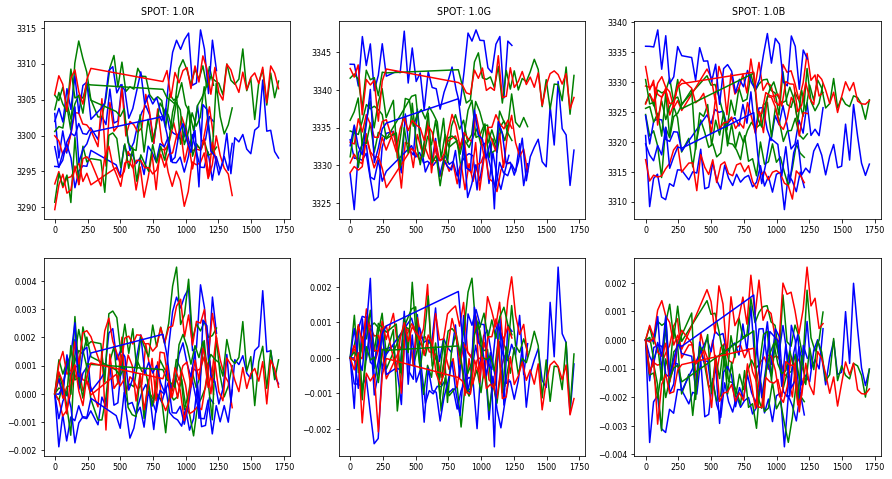

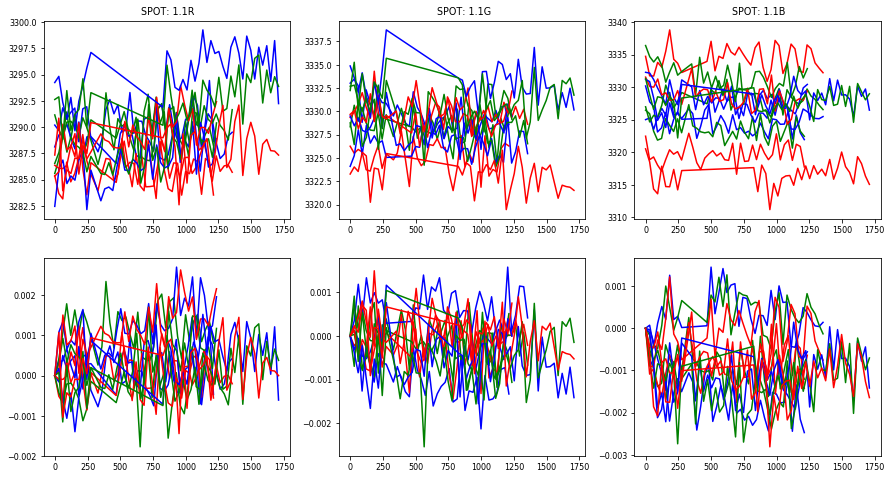

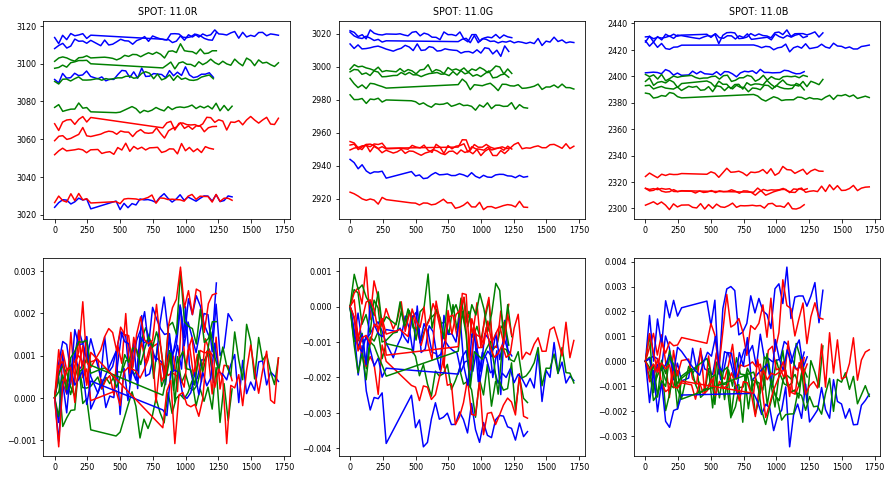

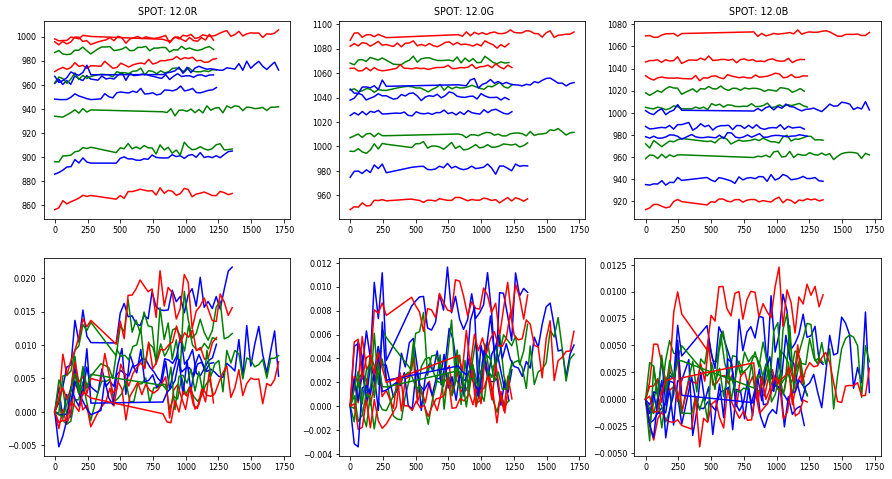

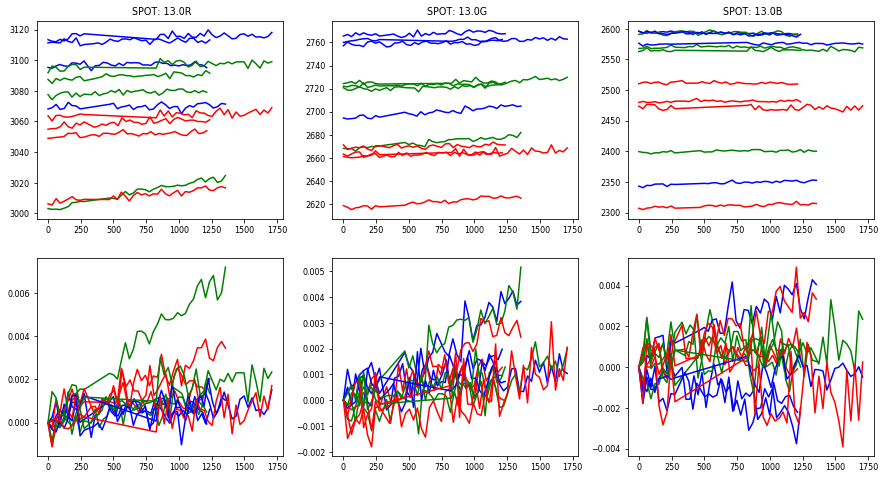

...

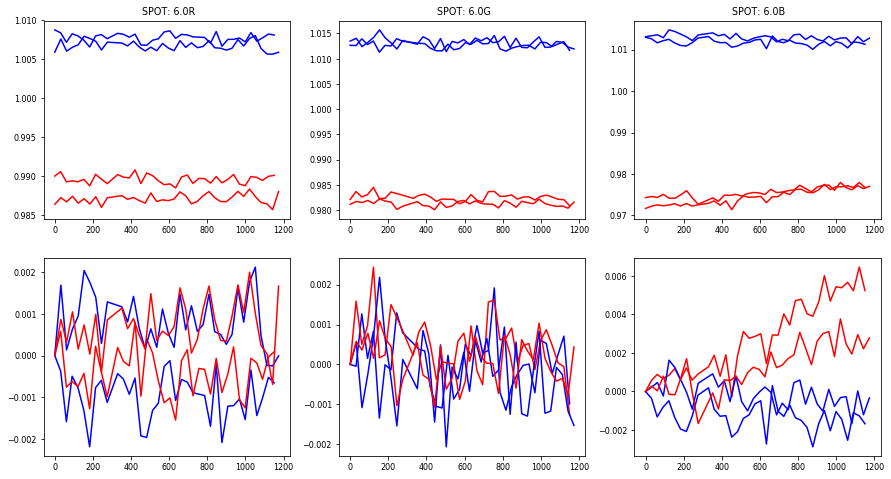

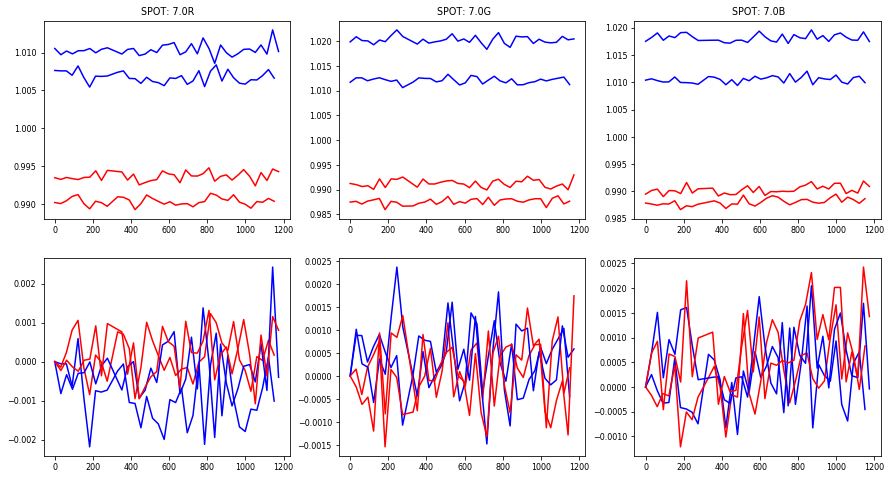

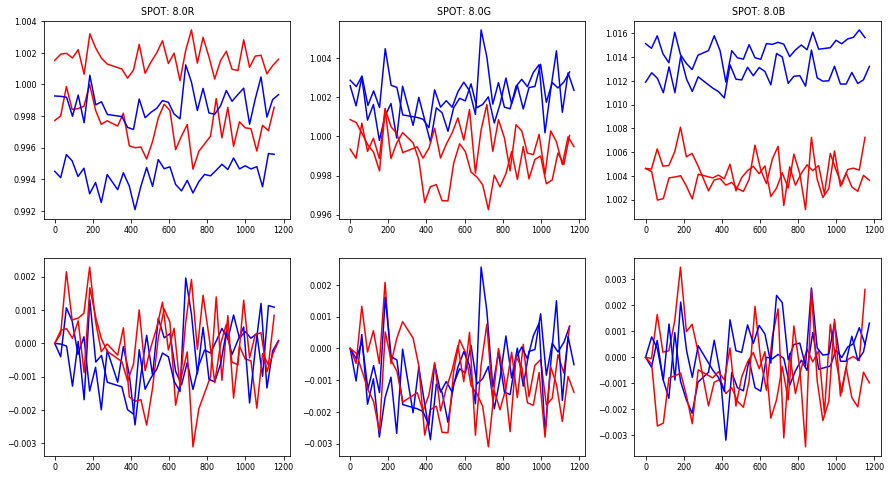

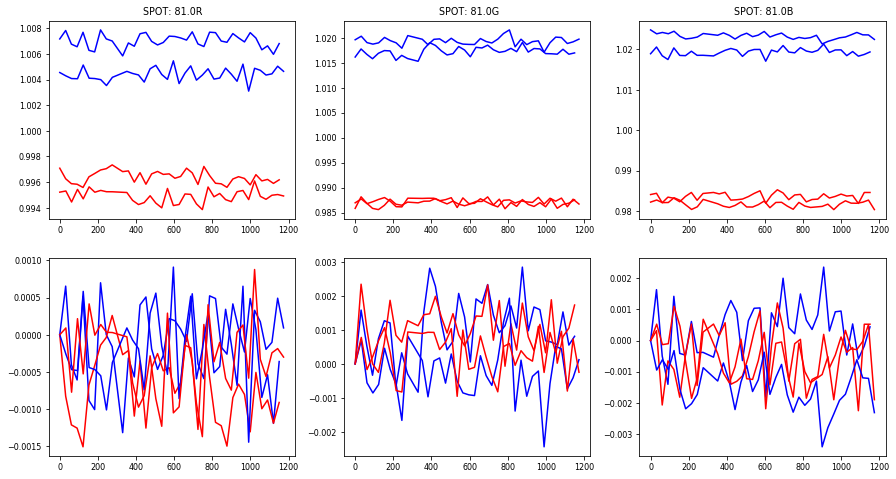

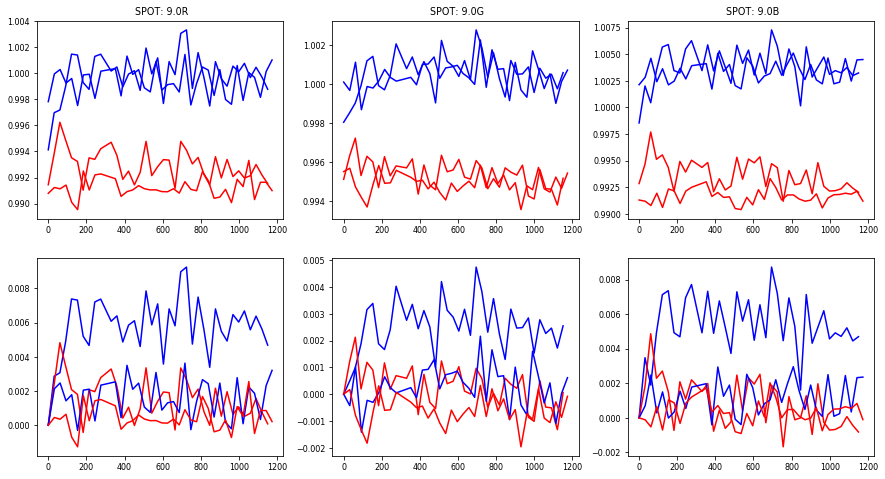

In [581]:
# Read in All Data
spotFiles = miscUtils.getFileList('*spotDF.csv')
spdfDict = {}
for f in spotFiles:
    spdf = pandas.read_csv(f)
    spdf['SpotNR'] = spdf['SpotID'].apply(lambda x: '.'.join(x.split('.')[:2]))
    tiral = f.split('-spotDF')[0].split('_')[-1]
    spdfDict[tiral] = spdf
# Visualize data
plotResponse(spdfDict)
# Analyze Data
allDF, I, D = analyzeResponse(spdfDict, ignoreTrials=['trial2','trial4','trial5'])
# Categorize Data
allDF_MEAN = allDF.groupby(['Conc','Spot']).mean()
allDF_MEAN['CAT'] = allDF_MEAN.apply(lambda x: categorize(x),axis=1)

In [582]:
#result
allDF_MEAN[(allDF_MEAN['CAT']=='CAT1') | (allDF_MEAN['CAT'] == 'CAT4')].groupby(['Conc','CAT','Spot']).sum()

,,,DeltaIDifference,IntensityRatio,StdRef
Conc,CAT,Spot,,,
85,CAT4,16.0G,0.034015,1.016909,0.020796


# Analyze H2S

In [554]:
os.chdir('../H2S/')
os.getcwd()

'M:\\AST-ID-QC\\2018\\IntensityStudy\\Analyte_Response\\Lab_Analyte\\H2S'

C:\Anaconda3\lib\site-packages\matplotlib\pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


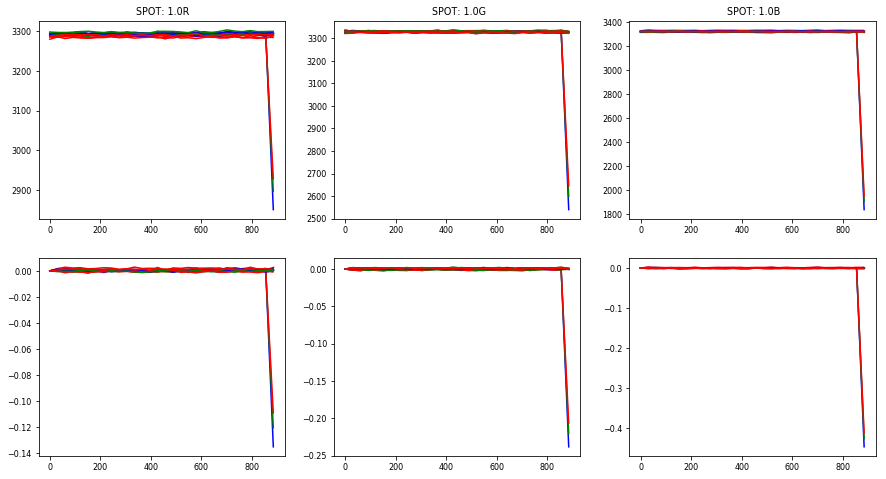

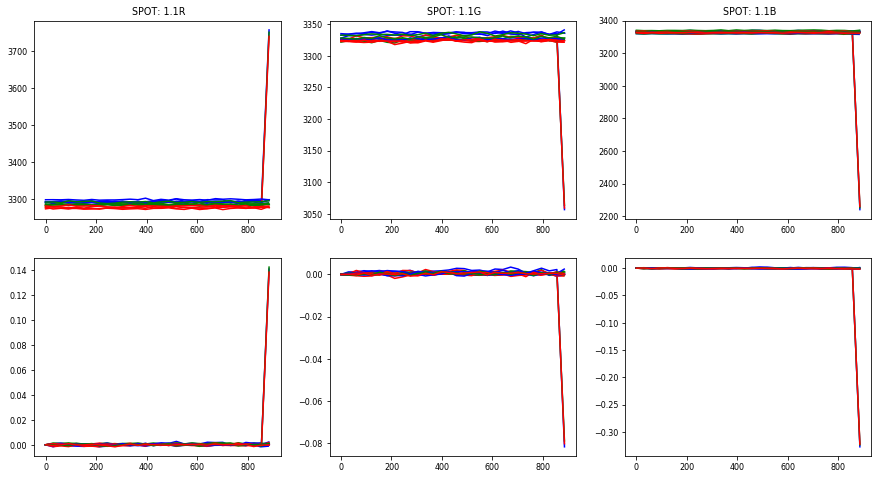

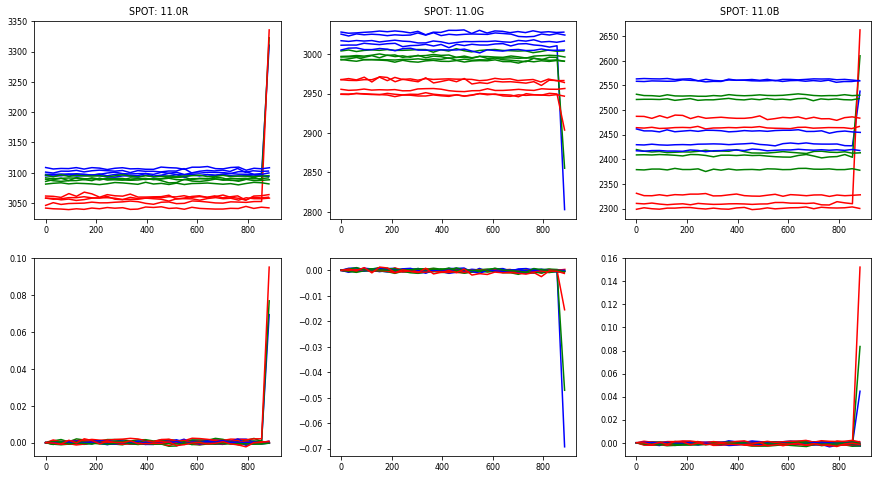

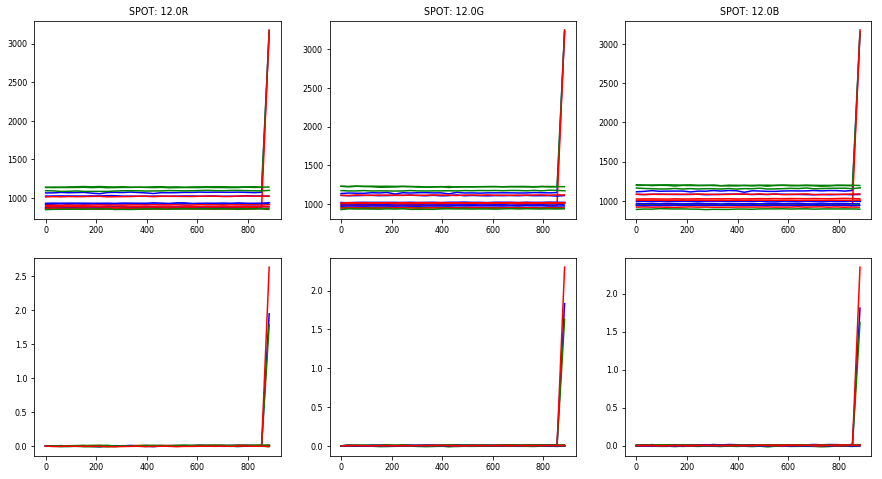

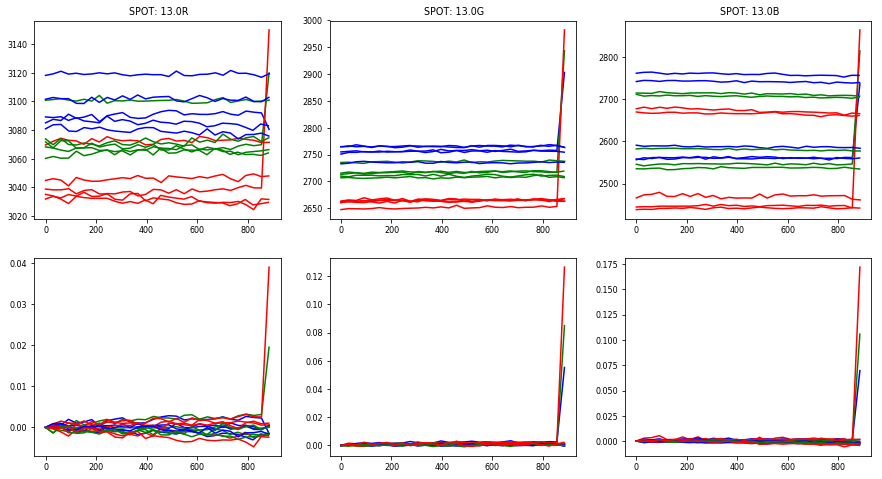

...

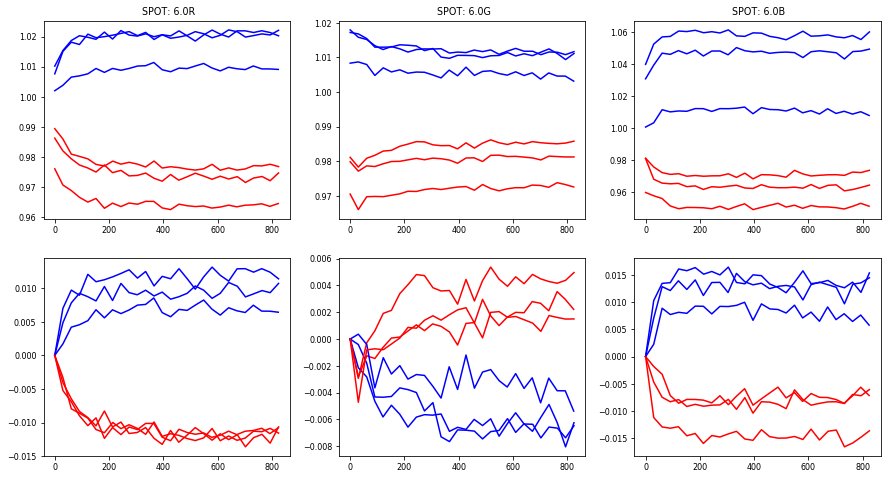

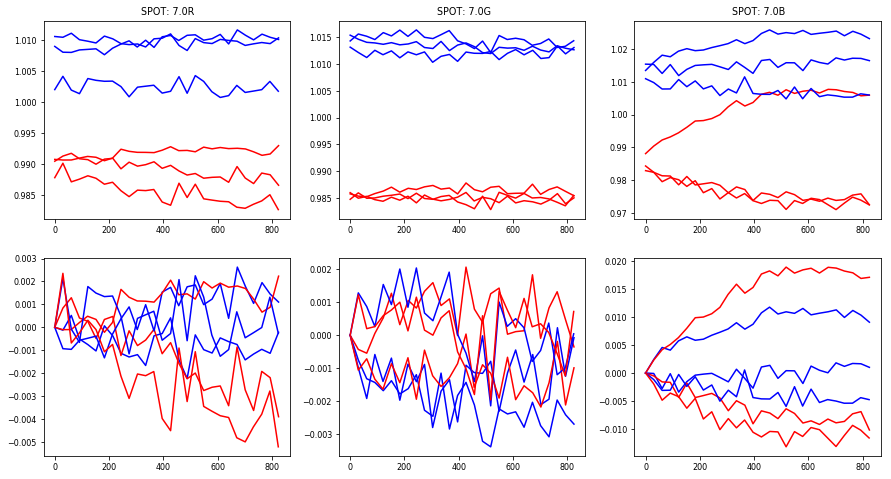

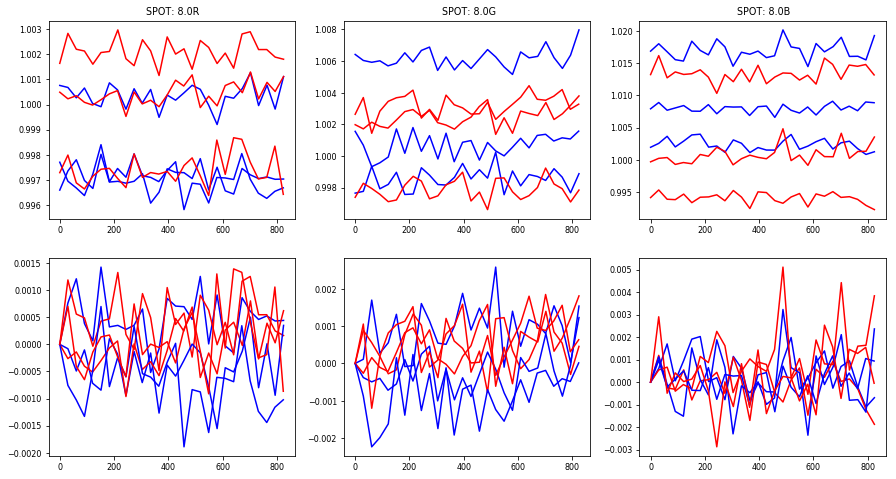

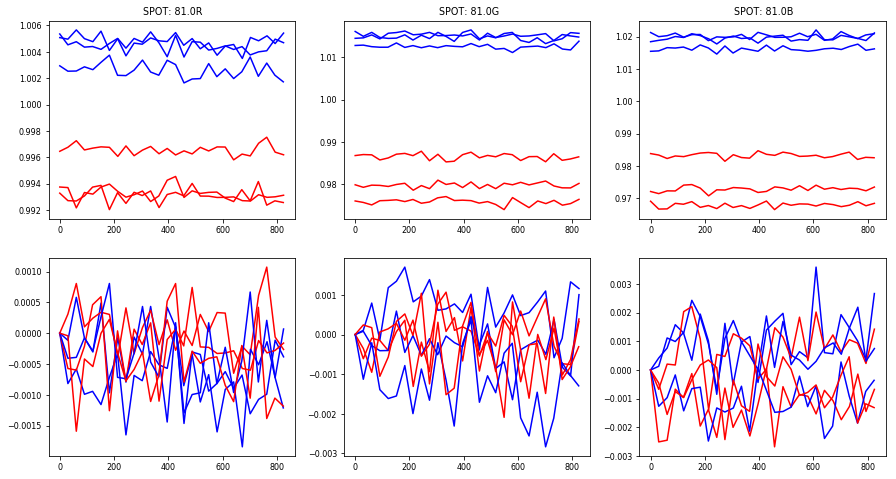

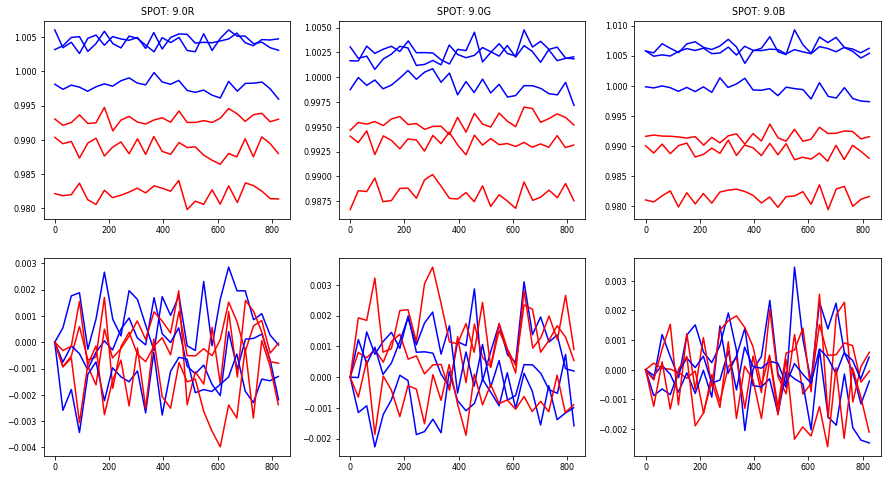

In [578]:
# Read in All Data
spotFiles = miscUtils.getFileList('*spotDF.csv')
spdfDict = {}
for f in spotFiles:
    spdf = pandas.read_csv(f)
    spdf['SpotNR'] = spdf['SpotID'].apply(lambda x: '.'.join(x.split('.')[:2]))
    tiral = f.split('-spotDF')[0].split('_')[-1]
    spdfDict[tiral] = spdf
# Visualize data
plotResponse(spdfDict)
# Analyze Data
allDF, I, D = analyzeResponse(spdfDict, ignoreTrials=['trial4','trial5'])
# Categorize Data
allDF_MEAN = allDF.groupby(['Conc','Spot']).mean()
allDF_MEAN['CAT'] = allDF_MEAN.apply(lambda x: categorize(x),axis=1)

In [579]:
#result
allDF_MEAN[(allDF_MEAN['CAT']=='CAT1') | (allDF_MEAN['CAT'] == 'CAT4')].groupby(['Conc','CAT','Spot']).sum()

DeltaIDifference  IntensityRatio    StdRef
Conc CAT  Spot                                             
115  CAT1 6.0B          -0.010020        0.963475  0.037487
          6.0R          -0.011790        0.974849  0.017269
85   CAT1 14.0B         -0.014148        1.026184  0.022518
          6.0B           0.011474        1.037093  0.037487

In [576]:
allDF_MEAN.loc[('85','14.0B'),]

DeltaIDifference    -0.014148
IntensityRatio        1.02618
StdRef              0.0225182
CAT                      CAT2
Name: (85, 14.0B), dtype: object

# Let's do the Micro Bacteria

In [598]:
os.chdir('../../../../../Micro/')

In [599]:
cd ./20180510_QC_Region1_Trp/

M:\AST-ID-QC\2018\IntensityStudy\Analyte_Response\Micro\20180510_QC_Region1_Trp


In [600]:
imageList = miscUtils.getFileList('*tiff')

In [601]:
folderList = list(set([ os.path.dirname(f) for f in imageList]))

In [602]:
folderList

['.\\Q25_68\\A_baumannii\\Frame-14',
 '.\\27853_35\\P_aeruginosa\\Frame-7',
 '.\\6303_81\\S_pneumoniae\\Frame-17',
 '.\\25922_122\\E_coli\\Frame-3',
 '.\\Media_92\\Control\\Frame-20',
 '.\\6303_90\\S_pneumoniae\\Frame-18',
 '.\\29213_57\\S_aureus\\Frame-10',
 '.\\29213_141\\S_aureus\\Frame-12',
 '.\\33495_130\\K_pneumoniae\\Frame-6',
 '.\\25922_14\\E_coli\\Frame-1',
 '.\\29213_66\\S_aureus\\Frame-11',
 '.\\27853_111\\P_aeruginosa\\Frame-9',
 '.\\33495_58\\K_pneumoniae\\Frame-4',
 '.\\Media_124\\Control\\Frame-21',
 '.\\Q25_38\\A_baumannii\\Frame-13',
 '.\\27853_64\\P_aeruginosa\\Frame-8',
 '.\\25922_77\\E_coli\\Frame-2',
 '.\\6303_39\\S_pneumoniae\\Frame-16',
 '.\\33495_79\\K_pneumoniae\\Frame-5',
 '.\\Q25_135\\A_baumannii\\Frame-15',
 '.\\Media_63\\Control\\Frame-19']

In [643]:
def processFolderMicro(foldername, region='region1',maxFiles=90):
    cwd = os.getcwd()
    try:
        os.chdir(foldername)
        imageList = sorted(miscUtils.getFileList('*.tiff'))
        logger.debug(' -- imageList: {0}'.format(imageList))
        filebase = os.path.basename(os.getcwd())
        Analyte = foldername.split('\\')[1]
        Strain = foldername.split('\\')[2].split('_')[0]
        printRegion = foldername.split('\\')[2].split('_')[1]
        Frame = foldername.split('\\')[3]
        h5filename = Analyte + '__' + Strain +'__' + Region + '__'+ Frame + '.h5'
        
        if 'region1' in region:
            sensor = 'QC-Rev11-Q1-60'
        elif 'region2' in region:
            sensor = 'QC-Rev11-Q2-60'
        else:
            logger.error('Unknown foldername {0}'.format(foldername))
            return   
        sensorDict = {}
        sensorDict['A1'] = sensor
        # create file
        logger.info('Createing file {0} in folder {1}'.format(h5filename, os.getcwd()))
        h = H5Utils.h5Parser(h5filename, sensorConfigDictString=str(sensorDict), forceNewFile=True)
        # metadat:
        metadata = {}
        fields = foldername.split('_')
        metadata['Region'] = region
        metadata['PrintRegion'] = printRegion
        metadata['Analyte'] = Analyte
        metadata['Strain'] = Strain
       
        date = imageList[0].strip('.\\tiff')
        metadata['UniqueId'] = os.path.basename(h5filename).strip('.h5') + '__' + date
        metaDataDict['A1'] = metadata
        h.writeDictAttribute(attrName='metaData', dataDict=metaDataDict)
        # process images
        h.buildH5File(filelist=imageList[:min(maxFiles,len(imageList))])
        # DeltaI/I
      #  h.refTimeMin = 5
        h.astAlgoConfig['smoothMethod'] = None
        spdf = h.addDeltaItoSpotDF()
        spdf['UniqueId'] = foldername
        spdf.to_csv(filebase + '-spotDF.csv')
        os.chdir(cwd)
    except:
        logger.error(' Something went awry ')
        logger.error('',exc_info=True)
        os.chdir(cwd)
    return    

In [647]:
logger.setLevel(logging.INFO)
for folder in folderList[:3]:
    processFolderMicro(folder)

Createing file Q25_68__A__baumannii__Frame-14.h5 in folder M:\AST-ID-QC\2018\IntensityStudy\Analyte_Response\Micro\20180510_QC_Region1_Trp\Q25_68\A_baumannii\Frame-14
Writing astConfigDict as attribute
 Using config from self.astConfigDict[A1]
Writing astAlgoConfig as attribute
 Extracting spots ..
 parsing image .\2018-05-10_18-56-27.tiff - 10/90  elapsed time: 0:00:13.631287
 parsing image .\2018-05-10_20-36-28.tiff - 20/90  elapsed time: 0:00:28.667446
 parsing image .\2018-05-10_22-16-29.tiff - 30/90  elapsed time: 0:00:42.879188
 parsing image .\2018-05-10_23-56-31.tiff - 40/90  elapsed time: 0:00:58.602530
 parsing image .\2018-05-11_01-36-36.tiff - 50/90  elapsed time: 0:01:13.783793
 parsing image .\2018-05-11_03-16-40.tiff - 60/90  elapsed time: 0:01:28.587135
 parsing image .\2018-05-11_04-56-47.tiff - 70/90  elapsed time: 0:01:44.061304
 parsing image .\2018-05-11_06-36-48.tiff - 80/90  elapsed time: 0:01:59.245672
 parsing image .\2018-05-11_08-16-51.tiff - 90/90  elapsed t

In [641]:
os.listdir()

['6303_81',
 'Configuration.xml',
 'InstrumentLog.csv',
 '29213_141',
 'Media_124',
 '25922_77',
 'TrialInfo.xml',
 '33495_130',
 '27853_111',
 '25922_14',
 'Q25_68',
 '27853_35',
 '33495_58',
 '29213_66',
 'ImageLog.csv',
 '33495_79',
 'Q25_135',
 'Media_92',
 'ClassificationHistory.csv',
 '25922_122',
 'Q25_38',
 '27853_64',
 'Media_63',
 '6303_90',
 '29213_57',
 '6303_39']

In [617]:
folder = folderList[0]
cwd = os.getcwd()
os.chdir(folder)
imageList = sorted(miscUtils.getFileList('*.tiff'))
logger.debug(' -- imageList: {0}'.format(imageList))
filebase = os.path.basename(os.getcwd())
Analyte = folder.split('\\')[1]
Strain = folder.split('\\')[2].split('_')[0]
Region = folder.split('\\')[2].split('_')[1]
Frame = folder.split('\\')[3]
h5filename = Analyte + '__' + Strain +'__' + Region + '__'+ Frame + '.h5'
h5filename

'Q25_68__A__baumannii__Frame-14.h5'

In [612]:
folderList[0].split('\\')


['.', 'Q25_68', 'A_baumannii', 'Frame-14']

In [622]:
imageList[0].strip('.\\tiff')

'2018-05-10_17-26-12'